# Testing notebook for nifty fit on atmosphere TODs directly (no image)

# Try to add a nifty model for sampling the input map

numpy version: 2.1.1


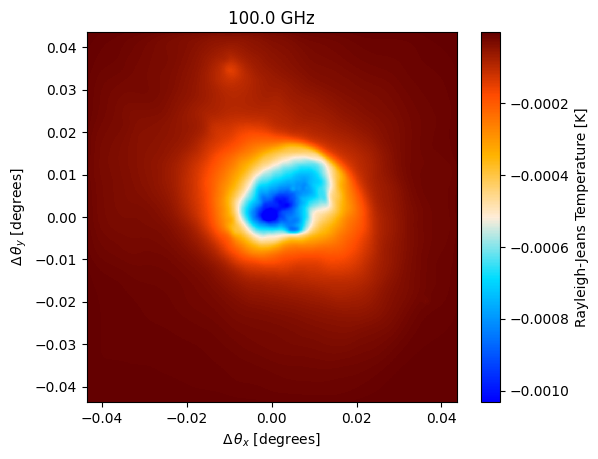

In [1]:
import numpy as np
print(f"numpy version: {np.__version__}")
import matplotlib.pyplot as plt
import maria
import sys
import os

# Relative import of sample_maps for now
sys.path.append(os.path.abspath('../python'))
import mapsampling_jax
from mapsampling_jax import sample_maps

map_filename = maria.io.fetch("maps/cluster.fits")

# load in the map from a fits file
input_map = maria.map.read_fits(filename=map_filename, #filename
                                resolution=8.714e-05, #pixel size in degrees
                                index=0, #index for fits file
                                center=(150, 10), # position in the sky
                                units='Jy/pixel' # Units of the input map 
                               )

input_map.to(units="K_RJ").plot()

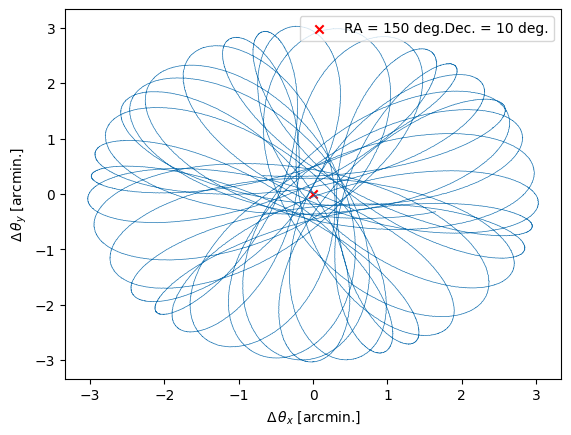

In [2]:
#load the map into maria
plan = maria.get_plan(scan_pattern="daisy", # scanning pattern
                      scan_options={"radius": 0.05, "speed": 0.01}, # in degrees
                      duration=600, # integration time in seconds
                    # duration=60,
                    #   duration=300, # integration time in seconds
                      sample_rate=50, # in Hz
                      scan_center=(150, 10), # position in the sky
                      frame="ra_dec")

plan.plot()

2024-10-15 13:09:33.575 INFO: Initialized base in 1530 ms.
Building atmosphere: 100%|██████████| 6/6 [00:04<00:00,  1.49it/s]
2024-10-15 13:09:38.929 INFO: Initialized atmosphere in 5340 ms.
Generating noise: 100%|██████████| 1/1 [00:00<00:00,  2.34it/s]


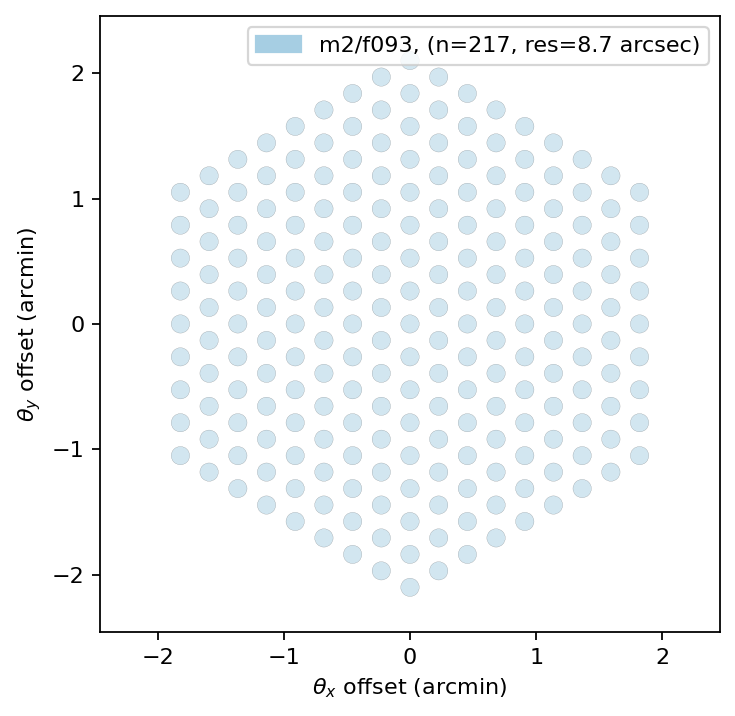

In [3]:
# instrument = maria.get_instrument('MUSTANG-2')
instrument = mapsampling_jax.instrument
instrument.plot()

sim_truthmap = maria.Simulation(instrument, 
                                plan=plan,
                                site="llano_de_chajnantor", 
                                map=input_map,
                                # noise=False,
                                atmosphere="2d",
                                # cmb="generate",
                                )

tod_truthmap = sim_truthmap.run()

In [4]:
dx, dy = sim_truthmap.coords.offsets(frame=sim_truthmap.map.frame, center=sim_truthmap.map.center)
dx = dx.compute()
dy = dy.compute()

dx

array([[-1.96330734e-04, -1.94205781e-04, -1.91102111e-04, ...,
         4.73398944e-04,  4.77186581e-04,  4.79144718e-04],
       [-2.45449865e-04, -2.43324934e-04, -2.40221390e-04, ...,
         4.28052333e-04,  4.31839737e-04,  4.33797864e-04],
       [-1.21140553e-04, -1.19015605e-04, -1.15911964e-04, ...,
         5.49276945e-04,  5.53064549e-04,  5.55022684e-04],
       ...,
       [ 1.21432157e-04,  1.23557294e-04,  1.26661988e-04, ...,
         7.60293782e-04,  7.64083311e-04,  7.66041527e-04],
       [-4.04899113e-04, -4.02773941e-04, -3.99669049e-04, ...,
         2.29147773e-04,  2.32937530e-04,  2.34895755e-04],
       [-7.45710094e-04, -7.43585155e-04, -7.40481565e-04, ...,
        -7.25622936e-05, -6.87749275e-05, -6.68168022e-05]])

Running mapper (m2/f093): 100%|██████████| 1/1 [00:05<00:00,  5.41s/it]


mapdata_truth shape: (1, 1000, 1000)
mapdata_truth mean: -8.726028151723567e-05


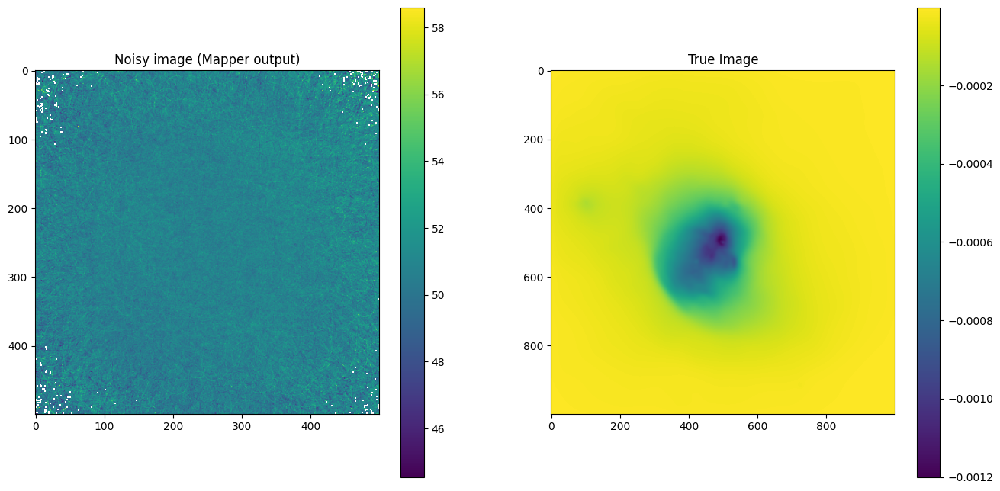

In [5]:
from maria.map.mappers import BinMapper

# Run mapper without any filtering to get noisy mimge
mapper_truthmap = BinMapper(center=(150, 10), frame="ra_dec", width=0.1, height=0.1, resolution=2e-4, map_postprocessing={"gaussian_filter": {"sigma": 0}} )
mapper_truthmap.add_tods(tod_truthmap)
output_truthmap = mapper_truthmap.run()

mapdata_truth = np.float64(sim_truthmap.map.data)
mapdata_truth = np.nan_to_num(mapdata_truth, nan=np.nanmean(mapdata_truth)) # replace nan value by img mean

print("mapdata_truth shape:", mapdata_truth.shape)
print("mapdata_truth mean:", mapdata_truth.mean())

fig, axes = plt.subplots(1, 2, figsize=(16, 8))

im0 = axes[0].imshow(output_truthmap.data[0].T)
fig.colorbar(im0)
axes[0].title.set_text("Noisy image (Mapper output)")

im1 = axes[1].imshow(mapdata_truth[0])
fig.colorbar(im1)
axes[1].title.set_text("True Image")

plt.show()

# Re-implement map sampling in JAX for nifty response function:

In [6]:
os.environ['CUDA_VISIBLE_DEVICES'] = '2'

import jax
from jax import random
import jax.numpy as jnp

import nifty8.re as jft
import matplotlib.pyplot as plt

import numpy as np

from functools import reduce
from operator import or_

seed = 42
key = random.PRNGKey(seed)

2024-10-15 13:09:52.500 INFO: Unable to initialize backend 'rocm': module 'jaxlib.xla_extension' has no attribute 'GpuAllocatorConfig'
2024-10-15 13:09:52.502 INFO: Unable to initialize backend 'tpu': INTERNAL: Failed to open libtpu.so: libtpu.so: cannot open shared object file: No such file or directory


# Test TOD agreement:

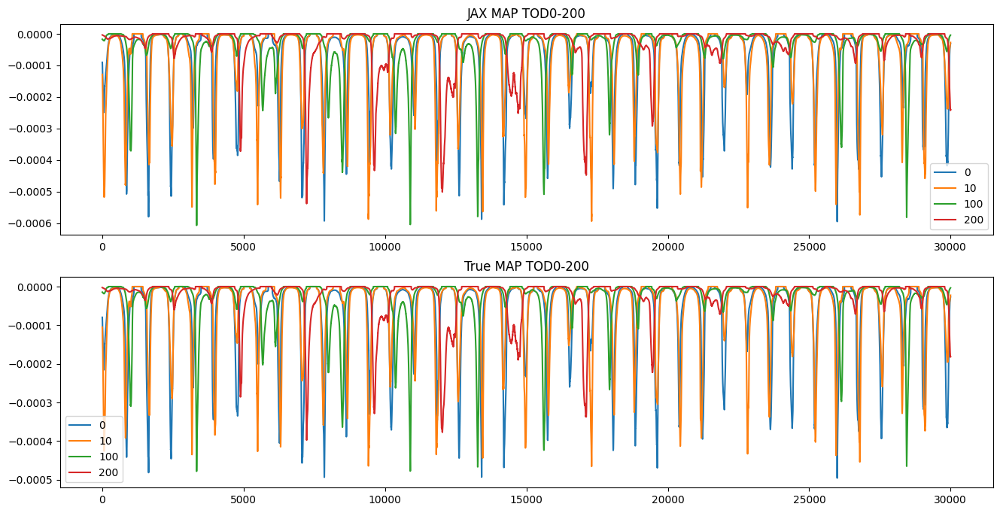

In [7]:
jax_tods_map = sample_maps(mapdata_truth, dx, dy, sim_truthmap.map.resolution, sim_truthmap.map.x_side, sim_truthmap.map.y_side)

fig, axes = plt.subplots(2, 1, figsize=(16, 8))

for i in [0, 10, 100, 200]:
    im0 = axes[0].plot(jax_tods_map[i], label=i)

    tods_map = np.float64(tod_truthmap.get_field('map').compute())
    im1 = axes[1].plot(tods_map[i], label=i)
    
axes[0].title.set_text(f'JAX MAP TOD0-{i}')
axes[0].legend()
axes[1].title.set_text(f'True MAP TOD0-{i}')
axes[1].legend()

plt.show()

/scratch/users/jwuerzin/miniconda3/envs/maria/lib/python3.11/site-packages/dask/array/core.py:1705: FutureWarning: The `numpy.interp` function is not implemented by Dask array. You may want to use the da.map_blocks function or something similar to silence this warning. Your code may stop working in a future release.
  warnings.warn(


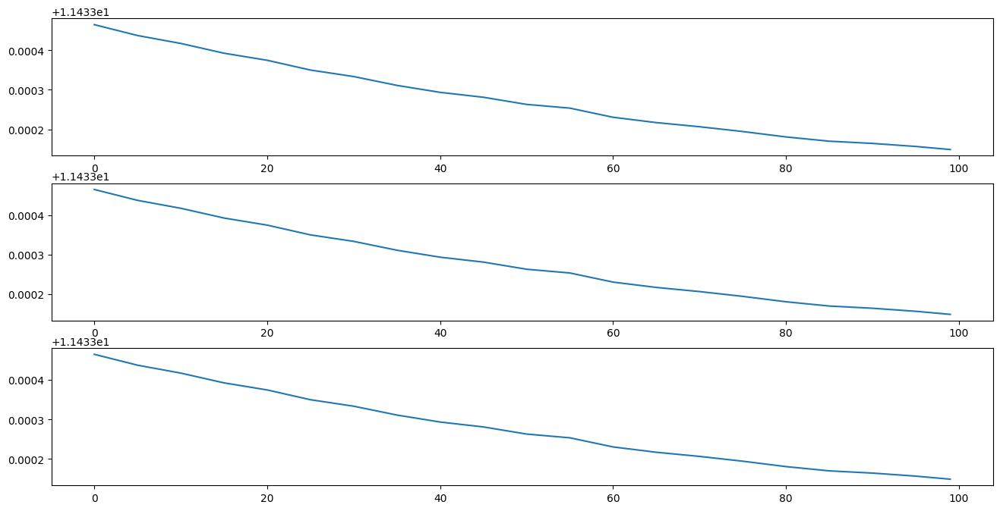

In [8]:
fig, axes = plt.subplots(3, 1, figsize=(16, 8))
# downsampling_factor = 25
downsampling_factor = 1
# downsampling_factor = 10

test_atmos = tod_truthmap.get_field('atmosphere')[0, :100]
downsampled_arr = test_atmos.reshape(-1, downsampling_factor).mean(axis=1)

original_size = test_atmos.size
downsampled_size = downsampled_arr.size

x_original = np.linspace(0, original_size - 1, original_size)
x_downsampled = np.linspace(0, original_size - 1, downsampled_size)

stretched_arr = np.interp(x_original, x_downsampled, downsampled_arr)
stretched_arr2 = np.repeat(downsampled_arr, downsampling_factor)

im0 = axes[0].plot(test_atmos, label='full')
im1 = axes[1].plot(downsampled_arr, label='downsampled')
im2 = axes[2].plot(stretched_arr)

# Prepare noised input TODs:

Noise stddev: 0.00025143236560964407


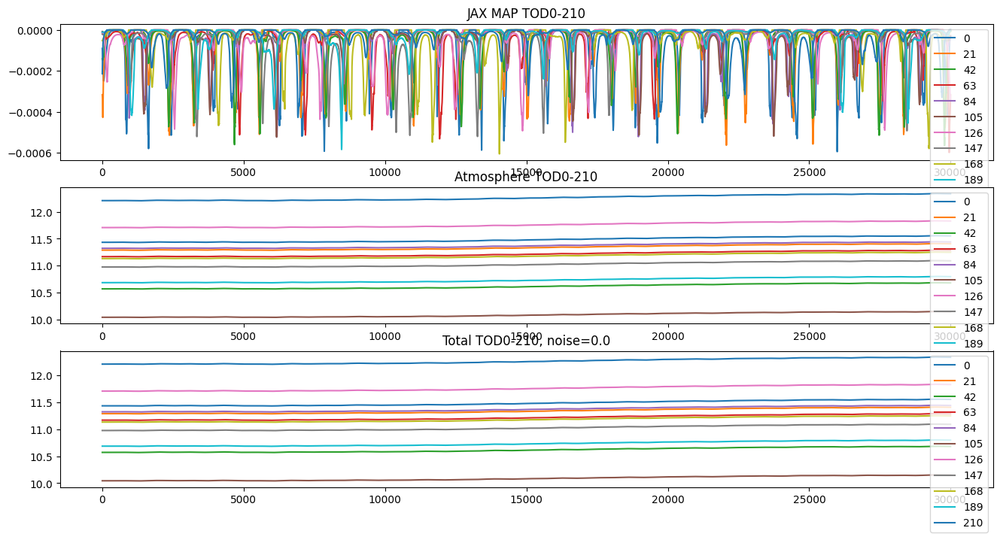

In [9]:
# Pick noise level for rest of run:
noiselevel = 0.0
# noiselevel = 0.1
# noiselevel = 0.5
# noiselevel = 1.0

# Add n TODs for atmos:
# n = 1
# n = 10
# n = 100
n = jax_tods_map.shape[0]

jax_tods_atmos = tod_truthmap.get_field('atmosphere')
# noised_jax_tod = np.float64(jax_tods_map) + np.float64(jax_tods_atmos) + np.float64(tod_truthmap.components['noise']*noiselevel)

noised_jax_tod = np.float64(jax_tods_map) + np.float64(tod_truthmap.get_field('noise')*noiselevel)
noised_jax_tod[:n] += np.float64(jax_tods_atmos[:n]) 
# noised_jax_tod[:n] = np.float64(jax_tods_atmos[:n])

denoised_jax_tod = noised_jax_tod - np.float64(tod_truthmap.get_field('noise')*noiselevel)

print("Noise stddev:", np.std(tod_truthmap.get_field('noise').compute()))

fig, axes = plt.subplots(3, 1, figsize=(16, 8))

for i in range(0, n, n//10):
    im0 = axes[0].plot(jax_tods_map[i], label=i)
    im1 = axes[1].plot(jax_tods_atmos[i], label=i)
    im2 = axes[2].plot(noised_jax_tod[i], label=i)
    
axes[0].title.set_text(f'JAX MAP TOD0-{i}')
axes[0].legend()
axes[1].title.set_text(f'Atmosphere TOD0-{i}')
axes[1].legend()
axes[2].title.set_text(f'Total TOD0-{i}, noise={noiselevel}')
axes[2].legend()

plt.show()

# Next, initialise nifty prior model

Start with the atmosphere TOD model:

In [10]:
padding_atmos = 2000
# padding_atmos = 200
dims_atmos = ( (jax_tods_atmos.shape[1] + padding_atmos)//downsampling_factor ,)

# correlated field zero mode GP offset and stddev
# cf_zm_tod = dict(offset_mean=jax_tods_atmos.mean().compute(), offset_std=(0.001, 0.1))
cf_zm_tod = dict(offset_mean=jax_tods_atmos.mean().compute(), offset_std=(0.0005, 0.001))

# correlated field fluctuations (mostly don't need tuning)
# fluctuations: y-offset in power spectrum in fourier space (zero mode)
# loglogavgslope: power-spectrum slope in log-log space in frequency domain (Fourier space) Jakob: -4 -- -2
# flexibility=(1.5e0, 5e-1), # deviation from simple power-law
# asperity=(5e-1, 5e-2), # small scale features in power-law
cf_fl_tod = dict(
    # fluctuations=(0.005, 0.005), 
    fluctuations=(0.005, 0.003), 
    loglogavgslope=(-3, 0.5), 
    flexibility=None,
    asperity=None,
)

# put together in correlated field model
cfm_tod = jft.CorrelatedFieldMaker("")
cfm_tod.set_amplitude_total_offset(**cf_zm_tod)
cfm_tod.add_fluctuations(
    dims_atmos, distances=1.0 / dims_atmos[0], **cf_fl_tod, prefix="tod ", non_parametric_kind="power"
)
gp_tod = cfm_tod.finalize()

## Add NormalPrior for atmosphere TODs y-offset 

In [11]:
# offset_dict = dict(mean = 0.0, std=1.0, shape=(n,))
# offset_tod = jft.NormalPrior(**offset_dict)
offset_tod = jft.NormalPrior(0.0, 1.0, name='offset', shape=(n,))

offset_tod

NormalPrior(
	<function wrap.<locals>.named_call at 0x14b2dfc2b4c0>,
	domain={'offset': ShapeWithDtype(shape=(217,), dtype=<class 'jax.numpy.float64'>)},
	init=Initializer({'offset': functools.partial(<function random_like at 0x14b2dc10a520>, primals=ShapeWithDtype(shape=(217,), dtype=<class 'jax.numpy.float64'>))})
)

## Add one Correlated field per TOD with shared flucts and zero-mean

In [12]:
# # init params for each TOD:

# gps_tods = []
# for i in range(n):
#     cfmi = jft.CorrelatedFieldMaker(f'tod{i} ')
#     # cfmi.set_amplitude_total_offset(**cf_zm_tod)
#     cfmi._azm = cfm_tod._azm
#     cfmi._offset_mean = cfm_tod._offset_mean
#     cfmi._parameter_tree['zeromode'] = jft.ShapeWithDtype(())

#     cfmi._fluctuations.append(cfm_tod._fluctuations[0])
#     cfmi._target_grids.append(cfm_tod._target_grids[0])
#     cfmi._parameter_tree.update(cfm_tod._fluctuations[0].domain)
#     gps_tods.append(cfmi.finalize())

## Now for the map model:

In [13]:
dims_map = (1000, 1000)

# Map model

# correlated field zero mode GP offset and stddev
# cf_zm_map = dict(offset_mean=mapdata_truth.mean(), offset_std=(1e-7, 1e-6))
cf_zm_map = dict(offset_mean=mapdata_truth.mean(), offset_std=(1e-8, 1e-7))
# correlated field fluctuations (mostly don't need tuning)
cf_fl_map = dict(
    # fluctuations=(1e-6, 1e-6), # fluctuations: y-offset in power spectrum in fourier space (zero mode)
    fluctuations=(2e-6, 1e-6), # fluctuations: y-offset in power spectrum in fourier space (zero mode)
    loglogavgslope=(-2.5e0, 5e-1), # power-spectrum slope in log-log space in frequency domain (Fourier space) Jakob: -4 -- -2
    flexibility=None,
    asperity=None,
    # flexibility=(1.5e0, 5e-1), # deviation from simple power-law
    # asperity=(5e-1, 5e-2), # small scale features in power-law
)

# put together in correlated field model
cfm_map = jft.CorrelatedFieldMaker("cfmap")
cfm_map.set_amplitude_total_offset(**cf_zm_map)
cfm_map.add_fluctuations(
    dims_map, distances=1.0 / dims_map[0], **cf_fl_map, prefix="ax1", non_parametric_kind="power"
)
gp_map = cfm_map.finalize()

In [14]:
# only tod:
# class Signal_TOD(jft.Model):
#     def __init__(self, gps_tods):
#         # self.gp_tod = gp_tod
#         # super().__init__(init=self.gp_tod.init, domain=jft.Vector(gp_tod.domain))
#         self.gps_tods = gps_tods
#         self.tgt = (len(gps_tods), gps_tods[0].target.size)
#         # self.gp_map = gp_map
#         # super().__init__(init=reduce(or_, [gp.init for gp in gps_tods] + [gp_map.init]), domain=reduce(or_, [gp.domain for gp in gps_tods] + [gp_map.domain]))
#         super().__init__(init=reduce(or_, [gp.init for gp in gps_tods]), domain=reduce(or_, [gp.domain for gp in gps_tods]))
    
#     def __call__(self, x):
#         res_tods = jnp.zeros(self.tgt)
#         for i, gp in enumerate(self.gps_tods):
#             res_tods = res_tods.at[i].set(gp(x))
        
#         return res_tods[:, padding_atmos//2:-padding_atmos//2]

#         # res_map = sample_maps(jax.numpy.broadcast_to(self.gp_map(x), (1, dims_map[0], dims_map[1])), dx, dy, sim_truthmap.map.resolution, sim_truthmap.map.x_side, sim_truthmap.map.y_side)

#         # # Only add first n atmosphere tods, otherwise use map
#         # modified_res_map = res_map.at[:n, :].add(res_tods[:, padding_atmos//2:-padding_atmos//2])

#         # return modified_res_map

# signal_response_tod = Signal_TOD(gps_tods)

# # map only:
# class Signal_TOD(jft.Model):
#     def __init__(self, gp_map):
#         # self.gp_tod = gp_tod
#         # super().__init__(init=self.gp_tod.init, domain=jft.Vector(gp_tod.domain))
#         # self.gps_tods = gps_tods
#         # self.tgt = (len(gps_tods), gps_tods[0].target.size)
#         self.gp_map = gp_map
#         # super().__init__(init=reduce(or_, [gp.init for gp in gps_tods] + [gp_map.init]), domain=reduce(or_, [gp.domain for gp in gps_tods] + [gp_map.domain]))
#         super().__init__(init=gp_map.init, domain=gp_map.domain)
    
#     def __call__(self, x):
#         # res_tods = jnp.zeros(self.tgt)
#         # for i, gp in enumerate(self.gps_tods):
#         #     res_tods = res_tods.at[i].set(gp(x))
        
#         res_map = sample_maps(jax.numpy.broadcast_to(self.gp_map(x), (1, dims_map[0], dims_map[1])), dx, dy, sim_truthmap.map.resolution, sim_truthmap.map.x_side, sim_truthmap.map.y_side)
#         return res_map

#         # Only add first n atmosphere tods, otherwise use map
#         # modified_res_map = res_map.at[:n, :].add(res_tods[:, padding_atmos//2:-padding_atmos//2])

#         # return modified_res_map
#         # return res_tods[:, padding_atmos//2:-padding_atmos//2] + res_map
#         # return res_tods[:, padding_atmos//2:-padding_atmos//2] + res_map[:n]
  
# signal_response_tod = Signal_TOD(gp_map)

# class Signal_TOD(jft.Model):
#     def __init__(self, gps_tods, gp_map, offset_tod):
#         # self.gp_tod = gp_tod
#         # super().__init__(init=self.gp_tod.init, domain=jft.Vector(gp_tod.domain))
#         self.gps_tods = gps_tods
#         self.tgt = (len(gps_tods), gps_tods[0].target.size * downsampling_factor)
#         self.gp_map = gp_map
#         self.offset_tod = offset_tod
#         super().__init__(init=reduce(or_, [gp.init for gp in gps_tods] + [gp_map.init, offset_tod.init]), domain=reduce(or_, [gp.domain for gp in gps_tods] + [gp_map.domain, offset_tod.domain]))
    
#     def __call__(self, x):
#         res_tods = jnp.zeros(self.tgt)
#         for i, gp in enumerate(self.gps_tods):
#             # Stretch atmosphere TODs to match map TODs size:
#             # downsampled_size = gp(x).size
#             # original_size = gp(x).size * downsampling_factor

#             # x_original = jax.numpy.linspace(0, original_size - 1, original_size)
#             # x_downsampled = jax.numpy.linspace(0, downsampled_size - 1, downsampled_size)

#             # stretched_gp = jax.numpy.interp(x_original, x_downsampled, gp(x))
#             stretched_gp = jax.numpy.repeat(gp(x), downsampling_factor)

#             # res_tods = res_tods.at[i].set(gp(x))
#             res_tods = res_tods.at[i].set(stretched_gp)

#         res_map = sample_maps(jax.numpy.broadcast_to(self.gp_map(x), (1, dims_map[0], dims_map[1])), dx, dy, sim_truthmap.map.resolution, sim_truthmap.map.x_side, sim_truthmap.map.y_side)

#         # Only add first n atmosphere tods, otherwise use map
#         modified_res_map = res_map.at[:n, :].add(res_tods[:, padding_atmos//2:-padding_atmos//2])

#         return modified_res_map
#         # return res_tods[:, padding_atmos//2:-padding_atmos//2] + res_map
#         # return res_tods[:, padding_atmos//2:-padding_atmos//2] + res_map[:n]

# signal_response_tod = Signal_TOD(gps_tods, gp_map)

In [15]:
# Define simple signal model with added map sampling
class Signal_TOD(jft.Model):
    def __init__(self, gp_tod, gp_map, offset_tod):
        # super().__init__(init=self.gp_tod.init, domain=jft.Vector(gp_tod.domain))
        self.gp_tod = gp_tod
        self.gp_map = gp_map
        self.offset_tod = offset_tod
        # super().__init__(init=reduce(or_, [gp_tod.init, gp_map.init, offset_tod.init]), domain=reduce(or_, [gp_tod.domain, gp_map.domain, offset_tod.domain]))
        super().__init__(init = self.gp_tod.init | self.gp_map.init | self.offset_tod.init, domain = self.gp_tod.domain | self.gp_map.domain | self.offset_tod.domain)
    
    def __call__(self, x):
        # Add offsets with shape (n_det,) to gp_tod with shape (n_timesteps,)
        res_tods = self.offset_tod(x)[:, jax.numpy.newaxis] + jax.numpy.repeat(self.gp_tod(x), downsampling_factor)[jax.numpy.newaxis, :]

        res_map = sample_maps(jax.numpy.broadcast_to(self.gp_map(x), (1, dims_map[0], dims_map[1])), dx, dy, sim_truthmap.map.resolution, sim_truthmap.map.x_side, sim_truthmap.map.y_side)

        # Only add first n atmosphere tods, otherwise use map
        modified_res_map = res_map.at[:n, :].add(res_tods[:, padding_atmos//2:-padding_atmos//2])

        return modified_res_map
        # return res_tods[:, padding_atmos//2:-padding_atmos//2] + res_map
        # return res_tods[:, padding_atmos//2:-padding_atmos//2] + res_map[:n]

signal_response_tod = Signal_TOD(gp_tod, gp_map, offset_tod)

# Define noise covariance
# if noiselevel == 0.0: noise_cov_inv_tod = lambda x: 2.5e-4**-2 * x
if noiselevel == 0.0: noise_cov_inv_tod = lambda x: 1e-8**-2 * x
elif noiselevel == 0.1: noise_cov_inv_tod = lambda x: 1e-4**-2 * x
elif noiselevel == 0.5: noise_cov_inv_tod = lambda x: 1e-4**-2 * x
elif noiselevel == 1.0: noise_cov_inv_tod = lambda x: 2.5e-4**-2 * x

# Combine in likelihood - only fit 0th TOD for now!
# truth = noised_jax_tod[:n]
truth = noised_jax_tod
lh_tod = jft.Gaussian( truth, noise_cov_inv_tod).amend(signal_response_tod)

# lh = lh_tod + lh_map
# lh = lh_map
lh = lh_tod

# lh_map_grad = jax.grad(lh_map)
lh_tod_grad = jax.grad(lh_tod)

assuming a diagonal covariance matrix;
setting `std_inv` to `cov_inv(ones_like(data))**0.5`


In [16]:
signal_response_tod

Signal_TOD(
	<bound method Signal_TOD.__call__>,
	domain={'cfmapax1fluctuations': ShapeWithDtype(shape=(), dtype=<class 'jax.numpy.float64'>),
	 'cfmapax1loglogavgslope': ShapeWithDtype(shape=(), dtype=<class 'jax.numpy.float64'>),
	 'cfmapxi': ShapeWithDtype(shape=(1000, 1000), dtype=<class 'jax.numpy.float64'>),
	 'cfmapzeromode': ShapeWithDtype(shape=(), dtype=<class 'jax.numpy.float64'>),
	 'offset': ShapeWithDtype(shape=(217,), dtype=<class 'jax.numpy.float64'>),
	 'tod fluctuations': ShapeWithDtype(shape=(), dtype=<class 'jax.numpy.float64'>),
	 'tod loglogavgslope': ShapeWithDtype(shape=(), dtype=<class 'jax.numpy.float64'>),
	 'xi': ShapeWithDtype(shape=(32000,), dtype=<class 'jax.numpy.float64'>),
	 'zeromode': ShapeWithDtype(shape=(), dtype=<class 'jax.numpy.float64'>)},
	init=Initializer(
		{'cfmapax1fluctuations': functools.partial(<function random_like at 0x14b2dc10a520>, primals=ShapeWithDtype(shape=(), dtype=<class 'jax.numpy.float64'>)),
		 'cfmapax1loglogavgslope': fun

# Draw Prior sample

(217, 30000)


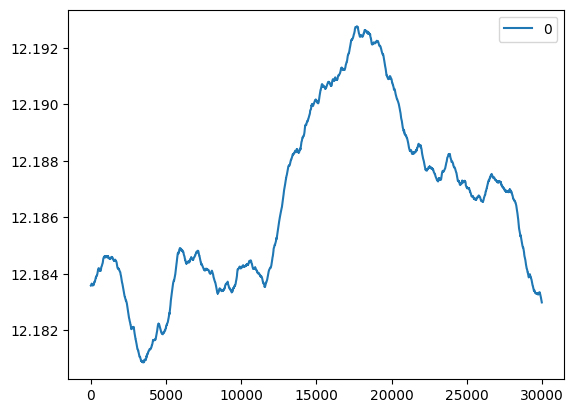

In [17]:
key, sub = jax.random.split(key)
xi = jft.random_like(sub, signal_response_tod.domain)
res = signal_response_tod(xi)
print(res.shape)

# for i in range(res.shape[0]):
# for i in range(0, n, n//10):
for i in [0]:
    plt.plot(np.arange(0, res.shape[1]), res[i], label=i)
plt.legend()
plt.show()

# MAP fit

In [18]:
n_it = 1
# delta = 1e-4 # default
# delta = 1e-8 # map
# tod
if noiselevel == 0.0: delta = 1e-4
elif noiselevel == 0.1: delta = 1e-10
elif noiselevel == 0.5: delta = 1e-10
elif noiselevel == 1.0: delta = 1e-4

n_samples = 0 # no samples -> maximum aposteriory posterior

key, k_i, k_o = random.split(key, 3)

samples, state = jft.optimize_kl(
    lh, # likelihood
    jft.Vector(lh.init(k_i)), # initial position in model space (initialisation)
    n_total_iterations=n_it, # no of optimisation steps (global)
    n_samples=n_samples, # draw samples
    key=k_o, # random jax init
    draw_linear_kwargs=dict( # sampling parameters
        cg_name="SL",
        cg_kwargs=dict(absdelta=delta * jft.size(lh.domain) / 10.0, maxiter=60),
    ),
    nonlinearly_update_kwargs=dict( # map from multivariate gaussian to more compl. distribution (coordinate transformations)
        minimize_kwargs=dict(
            name="SN",
            xtol=delta,
            cg_kwargs=dict(name=None),
            maxiter=5,
        )
    ),
    kl_kwargs=dict( # shift transformed multivar gauss to best match true posterior
        minimize_kwargs=dict(
            # name="M", xtol=delta, cg_kwargs=dict(name=None), maxiter=60 # map
            name="M", xtol=delta, cg_kwargs=dict(name=None), maxiter=20 # map
        )
    ),
    sample_mode="nonlinear_resample", # how steps are combined (samples + nonlin + KL)
)

OPTIMIZE_KL: Starting 0001
M: →:1.0 ↺:False #∇²:06 |↘|:2.747016e+02 ➽:1.032223e+02
M: Iteration 1 ⛰:+1.569083e+19 Δ⛰:4.397162e+22
M: →:0.125 ↺:False #∇²:12 |↘|:1.681194e+01 ➽:1.032223e+02
M: Iteration 2 ⛰:+1.189544e+19 Δ⛰:3.795392e+18
OPTIMIZE_KL: Iteration 0001 ⛰:+1.1895e+19
OPTIMIZE_KL: #(KL minimization steps) 2
OPTIMIZE_KL: Likelihood residual(s):
'reduced χ²: 3.7e+12±     0.0, avg: -2.3e+04±     0.0, #dof:6510000'

OPTIMIZE_KL: Prior residual(s):
cfmapax1fluctuations    :: 'reduced χ²:    0.27±     0.0, avg:    +0.52±     0.0, #dof:      1'
cfmapax1loglogavgslope  :: 'reduced χ²:    0.83±     0.0, avg:    -0.91±     0.0, #dof:      1'
cfmapxi                 :: 'reduced χ²:     1.0±     0.0, avg: -0.00055±     0.0, #dof:1000000'
cfmapzeromode           :: 'reduced χ²:    0.82±     0.0, avg:    +0.91±     0.0, #dof:      1'
offset                  :: 'reduced χ²:     0.3±     0.0, avg: +0.00011±     0.0, #dof:    217'
tod fluctuations        :: 'reduced χ²:    0.87±     0.0, avg:  

In [19]:
samples.pos

Vector(
	{'cfmapax1fluctuations': Array(0.52154383, dtype=float64),
	 'cfmapax1loglogavgslope': Array(-0.910594, dtype=float64),
	 'cfmapxi': Array([[ 0.7813502 ,  0.89001736,  0.13598335, ..., -0.04699517,
	         0.57755018,  1.5134288 ],
	       [-0.63880568,  1.27024732,  0.72703487, ...,  1.0004218 ,
	         0.3048352 , -1.21192544],
	       [ 2.4935362 ,  1.18749848, -1.82374253, ..., -0.69401682,
	         0.65527282, -0.06611052],
	       ...,
	       [ 0.73657976,  0.46379311,  0.73247035, ...,  0.25903783,
	        -0.66177725, -0.6901909 ],
	       [-0.92109574,  0.37655543, -0.65600882, ..., -0.48987457,
	         0.11348126,  0.62215035],
	       [-0.82961119,  1.26832718, -0.47735823, ...,  0.60836006,
	         0.76519817, -1.95999597]], dtype=float64),
	 'cfmapzeromode': Array(0.90783456, dtype=float64),
	 'offset': Array([ 2.89538797e-01,  1.40467985e-01, -2.17520457e-01, -2.33065360e-01,
	       -4.87892250e-01,  1.74101047e-01, -4.41306920e-01,  3.45560639e-01,
	

In [20]:
def printfitresults():
    print("Fit Results (res, init, std)")

    print("\nTODs:")
    print(f"\tfluctuations: {jft.LogNormalPrior(*cf_fl_tod['fluctuations'])(samples.pos['tod fluctuations'])}, {cf_fl_tod['fluctuations'][0]}, {cf_fl_tod['fluctuations'][1]}")
    print(f"\tloglogvarslope: {jft.NormalPrior(*cf_fl_tod['loglogavgslope'])(samples.pos['tod loglogavgslope'])}, {cf_fl_tod['loglogavgslope'][0]}, {cf_fl_tod['loglogavgslope'][1]}")
    print(f"\tzeromode std (LogNormal): {jft.LogNormalPrior(*cf_zm_tod['offset_std'])(samples.pos['zeromode'])}, {cf_zm_tod['offset_std'][0]}, {cf_zm_tod['offset_std'][1]}")

    # print(f"\toffset: {jft.NormalPrior(0.0, 1.0, shape=(n,))(samples.pos['offset'])}, 0.0, 1.0")

    # If custom zeromode per TOD:
    # for i in range(n):
    #     test = samples.pos[f"tod{i} zeromode"]
    #     print(f"tod{i} zeromode: {jft.LogNormalPrior(cf_zm_tod['offset_mean'], cf_zm_tod['offset_std'][0])(test)}, {cf_zm_tod['offset_mean']}, {cf_zm_tod['offset_std'][0]}")
    
    print("map:")
    print(f"\tfluctuations: {jft.LogNormalPrior(*cf_fl_map['fluctuations'])(samples.pos['cfmapax1fluctuations'])}, {cf_fl_map['fluctuations'][0]}, {cf_fl_map['fluctuations'][1]}")
    print(f"\tloglogvarslope: {jft.NormalPrior(*cf_fl_map['loglogavgslope'])(samples.pos['cfmapax1loglogavgslope'])}, {cf_fl_map['loglogavgslope'][0]}, {cf_fl_map['loglogavgslope'][1]}")
    print(f"\tzeromode std (LogNormal): {jft.LogNormalPrior(*cf_zm_map['offset_std'])(samples.pos['cfmapzeromode'])}, {cf_zm_map['offset_std'][0]}, {cf_zm_map['offset_std'][1]}")
    
printfitresults()

Fit Results (res, init, std)

TODs:
	fluctuations: 0.002559549921093648, 0.005, 0.003
	loglogvarslope: -4.077042217815393, -3, 0.5
	zeromode std (LogNormal): 0.0004868625001785762, 0.0005, 0.001
map:
	fluctuations: 2.2886054493631787e-06, 2e-06, 1e-06
	loglogvarslope: -2.955297001813918, -2.5, 0.5
	zeromode std (LogNormal): 6.995803895340895e-09, 1e-08, 1e-07


(217, 30000)


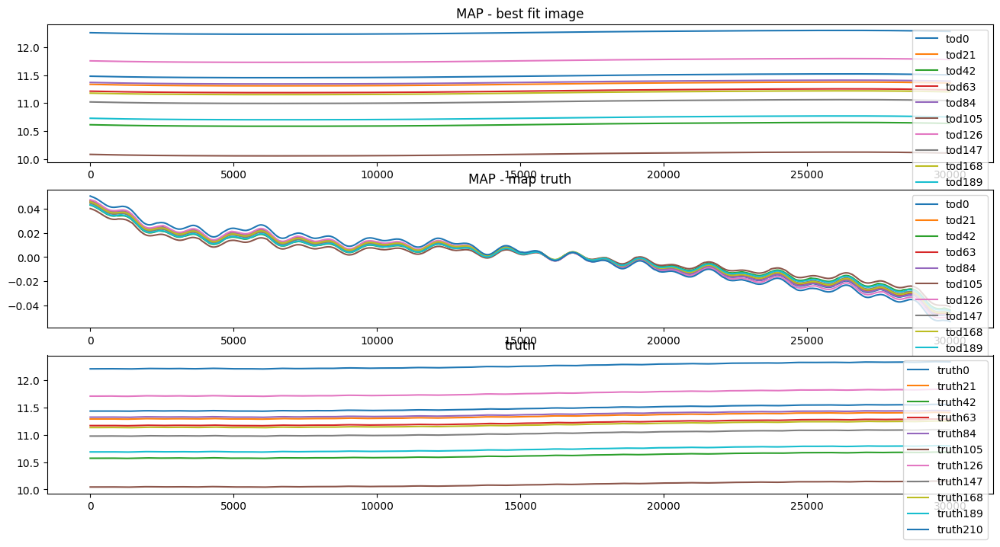

In [21]:
res = signal_response_tod(samples.pos)
print(res.shape)

fig, axes = plt.subplots(3, 1, figsize=(16, 8))

# for i in range(0, res.shape[0], res.shape[0]//10):
for i in range(0, n, n//10):
    im0 = axes[0].plot(np.arange(0, res.shape[1]), res[i], label=f"tod{i}")
    im1 = axes[1].plot(np.arange(0, res.shape[1]), res[i] - truth[i], label=f"tod{i}")
    im2 = axes[2].plot(truth[i], label=f"truth{i}")

axes[0].title.set_text('MAP - best fit image')
axes[0].legend()
axes[1].title.set_text('MAP - map truth')
axes[1].legend()
axes[2].title.set_text('truth')
axes[2].legend()

plt.show()

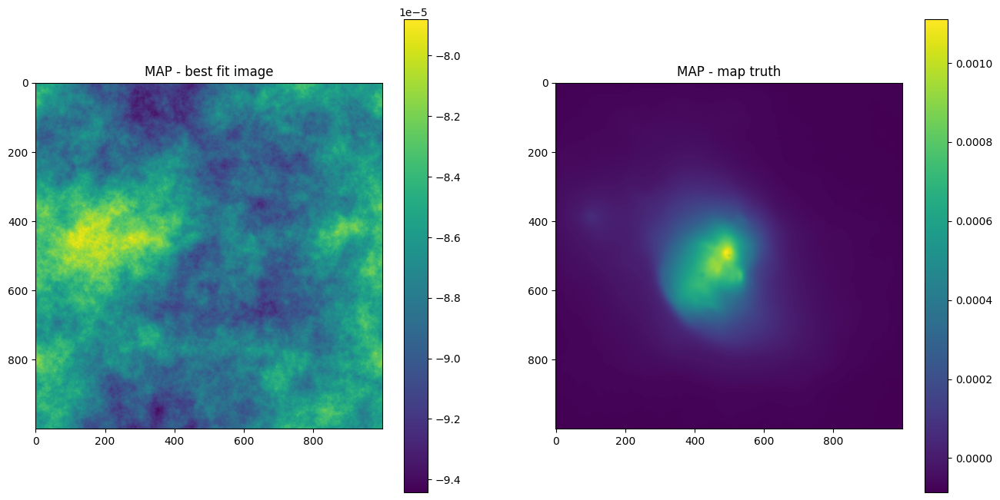

In [22]:
# plot maximum of posterior (mode)
sig_map = gp_map(samples.pos) # when splitting up in different field models

fig, axes = plt.subplots(1, 2, figsize=(16, 8))

im0 = axes[0].imshow(sig_map)
axes[0].title.set_text('MAP - best fit image')
fig.colorbar(im0)

im1 = axes[1].imshow( sig_map - mapdata_truth[0] )
axes[1].title.set_text('MAP - map truth')
# im1 = axes[1].imshow( (sig_map - mapdata_truth) )
# axes[1].title.set_text('diff prediction - map truth')
fig.colorbar(im1)

plt.show()

In [23]:
# assert False

## Full nifty fit:

OPTIMIZE_KL: Starting 0001
SL: Iteration 0 ⛰:+3.7736e+22 Δ⛰:inf ➽:1.0322e+01
SL: Iteration 1 ⛰:+4.9730e+17 Δ⛰:3.7735e+22 ➽:1.0322e+01
SL: Iteration 2 ⛰:+2.9570e+17 Δ⛰:2.0160e+17 ➽:1.0322e+01
SL: Iteration 3 ⛰:+8.9123e+16 Δ⛰:2.0658e+17 ➽:1.0322e+01
SL: Iteration 4 ⛰:+2.5886e+16 Δ⛰:6.3237e+16 ➽:1.0322e+01
SL: Iteration 5 ⛰:+1.2638e+16 Δ⛰:1.3249e+16 ➽:1.0322e+01
SL: Iteration 6 ⛰:+9.8583e+15 Δ⛰:2.7795e+15 ➽:1.0322e+01
SL: Iteration 7 ⛰:+8.5406e+15 Δ⛰:1.3177e+15 ➽:1.0322e+01
SL: Iteration 8 ⛰:+4.6777e+15 Δ⛰:3.8629e+15 ➽:1.0322e+01
SL: Iteration 9 ⛰:+3.7342e+15 Δ⛰:9.4349e+14 ➽:1.0322e+01
SL: Iteration 10 ⛰:+2.9562e+15 Δ⛰:7.7803e+14 ➽:1.0322e+01
SL: Iteration 11 ⛰:+2.3999e+15 Δ⛰:5.5630e+14 ➽:1.0322e+01
SL: Iteration 12 ⛰:+2.3986e+15 Δ⛰:1.3223e+12 ➽:1.0322e+01
SL: Iteration 13 ⛰:+1.5799e+15 Δ⛰:8.1864e+14 ➽:1.0322e+01
SL: Iteration 14 ⛰:+1.2032e+15 Δ⛰:3.7669e+14 ➽:1.0322e+01
SL: Iteration 15 ⛰:+1.0296e+15 Δ⛰:1.7369e+14 ➽:1.0322e+01
SL: Iteration 16 ⛰:+1.0247e+15 Δ⛰:4.8411e+12 ➽:1.0322e+01
SL: 

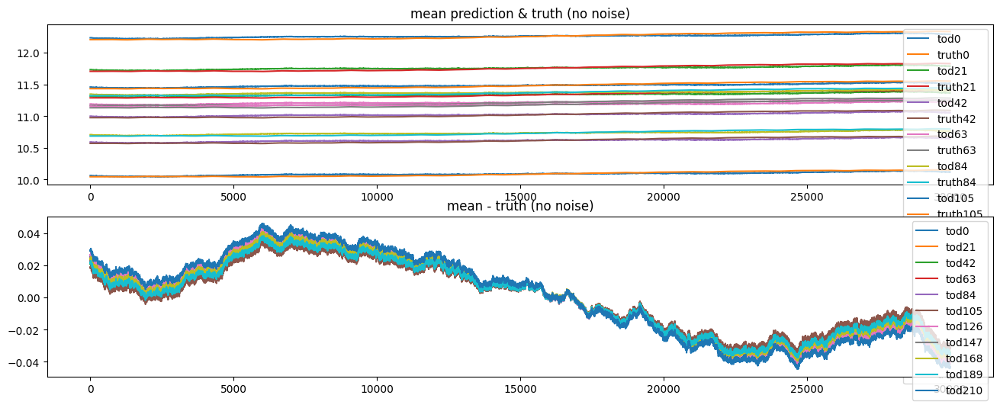

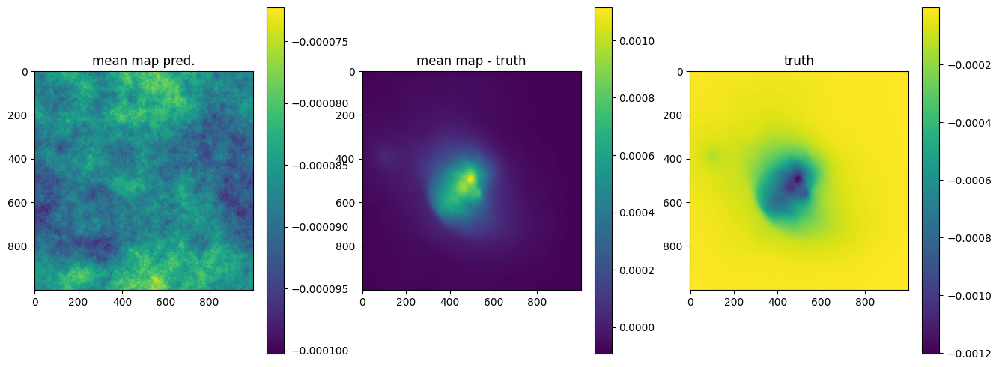

OPTIMIZE_KL: Starting 0002
SL: Iteration 0 ⛰:+3.6886e+22 Δ⛰:inf ➽:1.0322e+01
SL: Iteration 1 ⛰:+4.5569e+17 Δ⛰:3.6886e+22 ➽:1.0322e+01
SL: Iteration 2 ⛰:+1.4642e+17 Δ⛰:3.0926e+17 ➽:1.0322e+01
SL: Iteration 3 ⛰:+1.3022e+17 Δ⛰:1.6203e+16 ➽:1.0322e+01
SL: Iteration 4 ⛰:+1.2002e+17 Δ⛰:1.0202e+16 ➽:1.0322e+01
SL: Iteration 5 ⛰:+1.0279e+17 Δ⛰:1.7226e+16 ➽:1.0322e+01
SL: Iteration 6 ⛰:+8.1651e+16 Δ⛰:2.1142e+16 ➽:1.0322e+01
SL: Iteration 7 ⛰:+8.1643e+16 Δ⛰:8.2904e+12 ➽:1.0322e+01
SL: Iteration 8 ⛰:+6.0569e+16 Δ⛰:2.1074e+16 ➽:1.0322e+01
SL: Iteration 9 ⛰:+4.9856e+16 Δ⛰:1.0713e+16 ➽:1.0322e+01
SL: Iteration 10 ⛰:+4.9450e+16 Δ⛰:4.0632e+14 ➽:1.0322e+01
SL: Iteration 11 ⛰:+4.4604e+16 Δ⛰:4.8461e+15 ➽:1.0322e+01
SL: Iteration 12 ⛰:+4.3267e+16 Δ⛰:1.3366e+15 ➽:1.0322e+01
SL: Iteration 13 ⛰:+4.0966e+16 Δ⛰:2.3019e+15 ➽:1.0322e+01
SL: Iteration 14 ⛰:+4.0213e+16 Δ⛰:7.5239e+14 ➽:1.0322e+01
SL: Iteration 15 ⛰:+3.5579e+16 Δ⛰:4.6339e+15 ➽:1.0322e+01
SL: Iteration 16 ⛰:+3.1339e+16 Δ⛰:4.2399e+15 ➽:1.0322e+01
SL: 

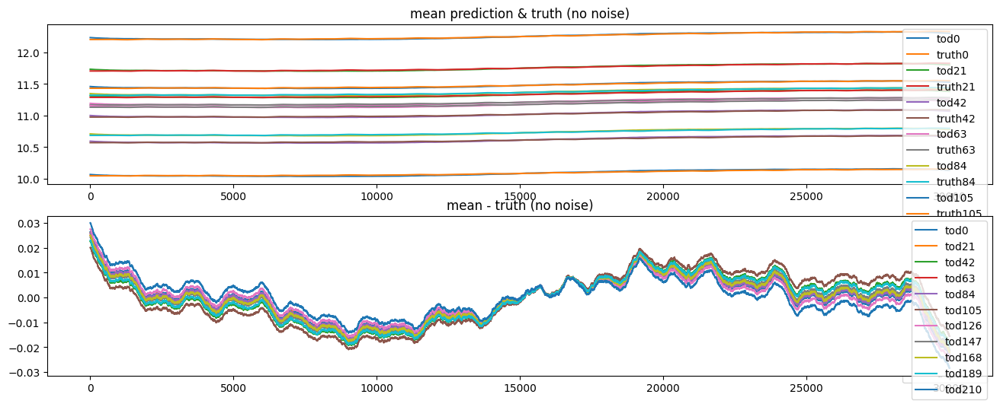

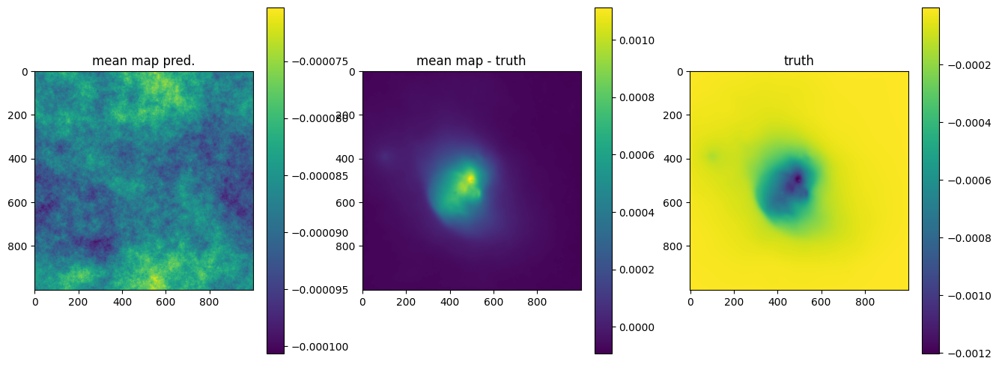

OPTIMIZE_KL: Starting 0003
SL: Iteration 0 ⛰:+3.1146e+22 Δ⛰:inf ➽:1.0322e+01
SL: Iteration 1 ⛰:+2.3775e+19 Δ⛰:3.1122e+22 ➽:1.0322e+01
SL: Iteration 2 ⛰:+2.4816e+17 Δ⛰:2.3527e+19 ➽:1.0322e+01
SL: Iteration 3 ⛰:+2.4563e+17 Δ⛰:2.5236e+15 ➽:1.0322e+01
SL: Iteration 4 ⛰:+1.3517e+17 Δ⛰:1.1047e+17 ➽:1.0322e+01
SL: Iteration 5 ⛰:+6.2598e+16 Δ⛰:7.2570e+16 ➽:1.0322e+01
SL: Iteration 6 ⛰:+4.4027e+16 Δ⛰:1.8572e+16 ➽:1.0322e+01
SL: Iteration 7 ⛰:+4.3542e+16 Δ⛰:4.8447e+14 ➽:1.0322e+01
SL: Iteration 8 ⛰:+2.7795e+16 Δ⛰:1.5747e+16 ➽:1.0322e+01
SL: Iteration 9 ⛰:+2.3262e+16 Δ⛰:4.5326e+15 ➽:1.0322e+01
SL: Iteration 10 ⛰:+1.7880e+16 Δ⛰:5.3820e+15 ➽:1.0322e+01
SL: Iteration 11 ⛰:+1.7879e+16 Δ⛰:1.0995e+12 ➽:1.0322e+01
SL: Iteration 12 ⛰:+1.5061e+16 Δ⛰:2.8183e+15 ➽:1.0322e+01
SL: Iteration 13 ⛰:+1.1256e+16 Δ⛰:3.8045e+15 ➽:1.0322e+01
SL: Iteration 14 ⛰:+1.1255e+16 Δ⛰:1.4114e+12 ➽:1.0322e+01
SL: Iteration 15 ⛰:+9.4414e+15 Δ⛰:1.8135e+15 ➽:1.0322e+01
SL: Iteration 16 ⛰:+8.1265e+15 Δ⛰:1.3149e+15 ➽:1.0322e+01
SL: 

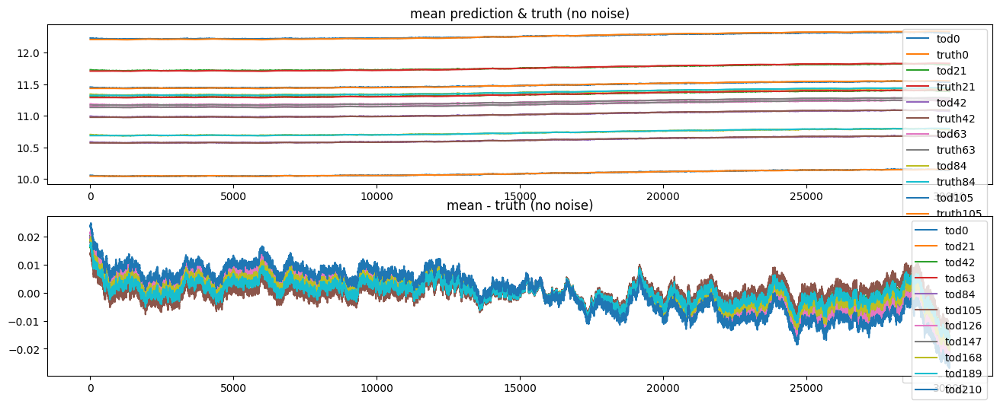

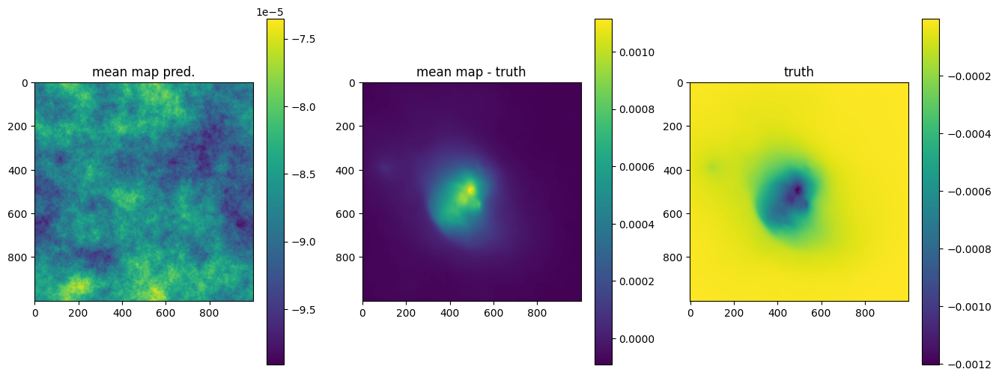

OPTIMIZE_KL: Starting 0004
SL: Iteration 0 ⛰:+3.0260e+22 Δ⛰:inf ➽:1.0322e+01
SL: Iteration 1 ⛰:+3.1233e+19 Δ⛰:3.0229e+22 ➽:1.0322e+01
SL: Iteration 2 ⛰:+2.9836e+17 Δ⛰:3.0934e+19 ➽:1.0322e+01
SL: Iteration 3 ⛰:+2.6414e+17 Δ⛰:3.4219e+16 ➽:1.0322e+01
SL: Iteration 4 ⛰:+1.7744e+17 Δ⛰:8.6705e+16 ➽:1.0322e+01
SL: Iteration 5 ⛰:+1.2610e+17 Δ⛰:5.1334e+16 ➽:1.0322e+01
SL: Iteration 6 ⛰:+9.9387e+16 Δ⛰:2.6715e+16 ➽:1.0322e+01
SL: Iteration 7 ⛰:+9.8414e+16 Δ⛰:9.7301e+14 ➽:1.0322e+01
SL: Iteration 8 ⛰:+7.4268e+16 Δ⛰:2.4147e+16 ➽:1.0322e+01
SL: Iteration 9 ⛰:+6.3732e+16 Δ⛰:1.0536e+16 ➽:1.0322e+01
SL: Iteration 10 ⛰:+6.3113e+16 Δ⛰:6.1927e+14 ➽:1.0322e+01
SL: Iteration 11 ⛰:+6.3103e+16 Δ⛰:9.2057e+12 ➽:1.0322e+01
SL: Iteration 12 ⛰:+5.4497e+16 Δ⛰:8.6059e+15 ➽:1.0322e+01
SL: Iteration 13 ⛰:+4.6313e+16 Δ⛰:8.1842e+15 ➽:1.0322e+01
SL: Iteration 14 ⛰:+4.6304e+16 Δ⛰:9.0636e+12 ➽:1.0322e+01
SL: Iteration 15 ⛰:+4.3918e+16 Δ⛰:2.3859e+15 ➽:1.0322e+01
SL: Iteration 16 ⛰:+3.8511e+16 Δ⛰:5.4073e+15 ➽:1.0322e+01
SL: 

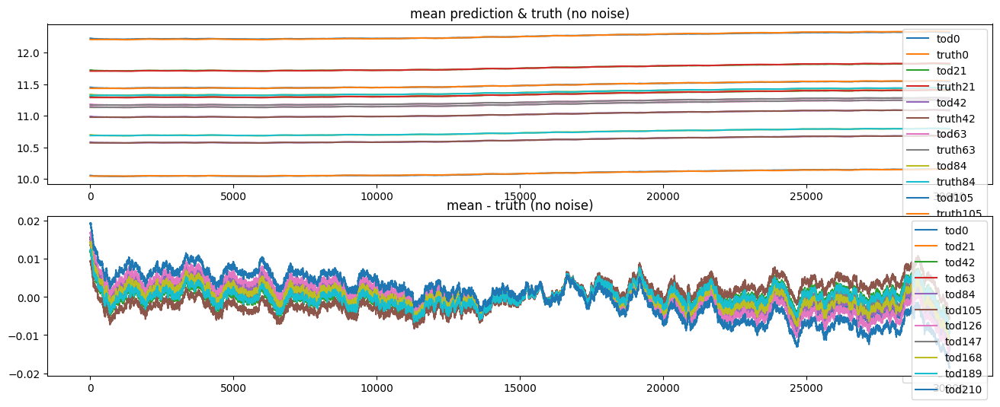

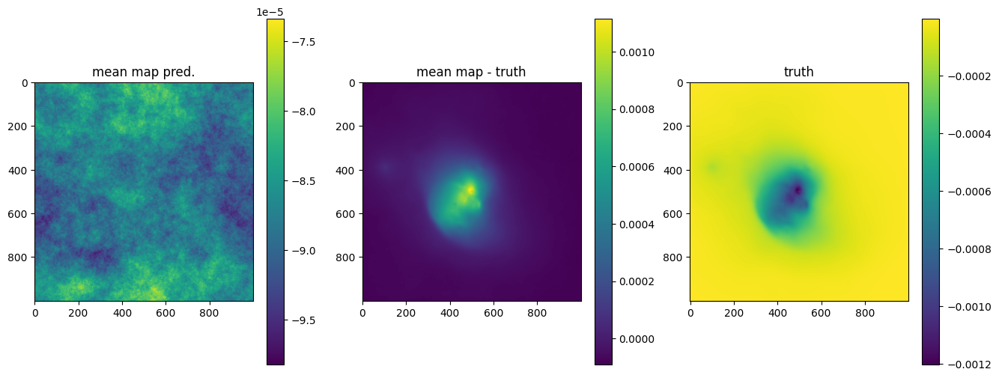

OPTIMIZE_KL: Starting 0005
SL: Iteration 0 ⛰:+2.7662e+22 Δ⛰:inf ➽:1.0322e+01
SL: Iteration 1 ⛰:+9.3001e+17 Δ⛰:2.7661e+22 ➽:1.0322e+01
SL: Iteration 2 ⛰:+2.3916e+17 Δ⛰:6.9085e+17 ➽:1.0322e+01
SL: Iteration 3 ⛰:+2.3769e+17 Δ⛰:1.4676e+15 ➽:1.0322e+01
SL: Iteration 4 ⛰:+1.8948e+17 Δ⛰:4.8213e+16 ➽:1.0322e+01
SL: Iteration 5 ⛰:+1.2543e+17 Δ⛰:6.4042e+16 ➽:1.0322e+01
SL: Iteration 6 ⛰:+8.7761e+16 Δ⛰:3.7673e+16 ➽:1.0322e+01
SL: Iteration 7 ⛰:+8.6476e+16 Δ⛰:1.2848e+15 ➽:1.0322e+01
SL: Iteration 8 ⛰:+6.0012e+16 Δ⛰:2.6464e+16 ➽:1.0322e+01
SL: Iteration 9 ⛰:+4.3632e+16 Δ⛰:1.6380e+16 ➽:1.0322e+01
SL: Iteration 10 ⛰:+4.3614e+16 Δ⛰:1.7712e+13 ➽:1.0322e+01
SL: Iteration 11 ⛰:+4.3611e+16 Δ⛰:3.2435e+12 ➽:1.0322e+01
SL: Iteration 12 ⛰:+3.6347e+16 Δ⛰:7.2640e+15 ➽:1.0322e+01
SL: Iteration 13 ⛰:+2.9862e+16 Δ⛰:6.4850e+15 ➽:1.0322e+01
SL: Iteration 14 ⛰:+2.9862e+16 Δ⛰:5.0817e+11 ➽:1.0322e+01
SL: Iteration 15 ⛰:+2.4785e+16 Δ⛰:5.0767e+15 ➽:1.0322e+01
SL: Iteration 16 ⛰:+2.0440e+16 Δ⛰:4.3452e+15 ➽:1.0322e+01
SL: 

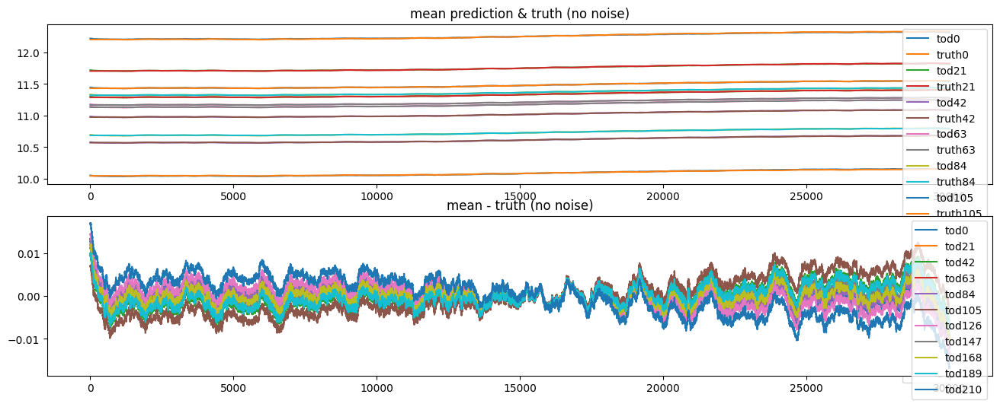

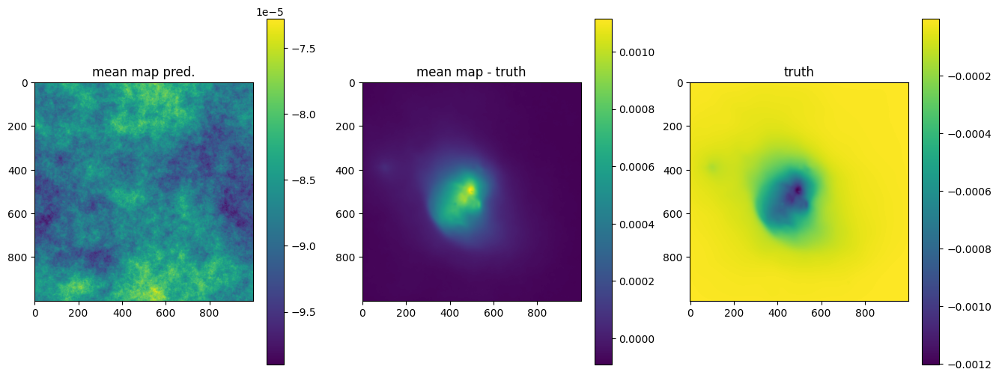

OPTIMIZE_KL: Starting 0006
SL: Iteration 0 ⛰:+3.1757e+22 Δ⛰:inf ➽:1.0322e+01
SL: Iteration 1 ⛰:+2.2535e+19 Δ⛰:3.1735e+22 ➽:1.0322e+01
SL: Iteration 2 ⛰:+6.6912e+17 Δ⛰:2.1866e+19 ➽:1.0322e+01
SL: Iteration 3 ⛰:+5.0329e+17 Δ⛰:1.6583e+17 ➽:1.0322e+01
SL: Iteration 4 ⛰:+2.5910e+17 Δ⛰:2.4418e+17 ➽:1.0322e+01
SL: Iteration 5 ⛰:+1.6059e+17 Δ⛰:9.8513e+16 ➽:1.0322e+01
SL: Iteration 6 ⛰:+8.5191e+16 Δ⛰:7.5400e+16 ➽:1.0322e+01
SL: Iteration 7 ⛰:+7.2343e+16 Δ⛰:1.2848e+16 ➽:1.0322e+01
SL: Iteration 8 ⛰:+6.1005e+16 Δ⛰:1.1339e+16 ➽:1.0322e+01
SL: Iteration 9 ⛰:+3.8456e+16 Δ⛰:2.2549e+16 ➽:1.0322e+01
SL: Iteration 10 ⛰:+3.8347e+16 Δ⛰:1.0834e+14 ➽:1.0322e+01
SL: Iteration 11 ⛰:+3.8340e+16 Δ⛰:7.3850e+12 ➽:1.0322e+01
SL: Iteration 12 ⛰:+3.2906e+16 Δ⛰:5.4337e+15 ➽:1.0322e+01
SL: Iteration 13 ⛰:+2.9745e+16 Δ⛰:3.1615e+15 ➽:1.0322e+01
SL: Iteration 14 ⛰:+2.9743e+16 Δ⛰:1.4353e+12 ➽:1.0322e+01
SL: Iteration 15 ⛰:+2.3868e+16 Δ⛰:5.8749e+15 ➽:1.0322e+01
SL: Iteration 16 ⛰:+2.1573e+16 Δ⛰:2.2952e+15 ➽:1.0322e+01
SL: 

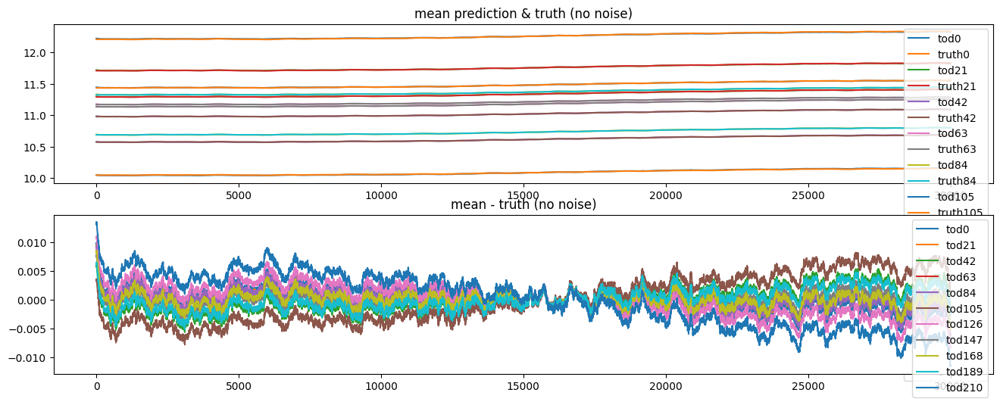

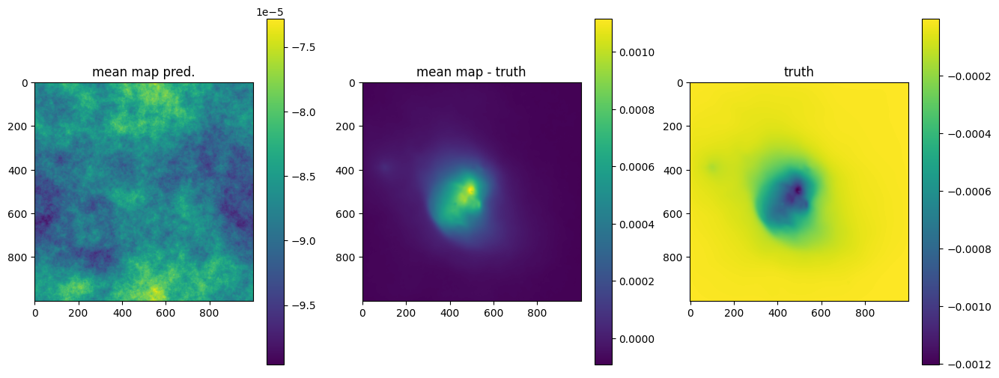

OPTIMIZE_KL: Starting 0007
SL: Iteration 0 ⛰:+3.1564e+22 Δ⛰:inf ➽:1.0322e+01
SL: Iteration 1 ⛰:+4.9327e+17 Δ⛰:3.1564e+22 ➽:1.0322e+01
SL: Iteration 2 ⛰:+3.4687e+17 Δ⛰:1.4640e+17 ➽:1.0322e+01
SL: Iteration 3 ⛰:+3.3127e+17 Δ⛰:1.5601e+16 ➽:1.0322e+01
SL: Iteration 4 ⛰:+2.2142e+17 Δ⛰:1.0985e+17 ➽:1.0322e+01
SL: Iteration 5 ⛰:+1.3350e+17 Δ⛰:8.7927e+16 ➽:1.0322e+01
SL: Iteration 6 ⛰:+7.2367e+16 Δ⛰:6.1130e+16 ➽:1.0322e+01
SL: Iteration 7 ⛰:+5.8156e+16 Δ⛰:1.4212e+16 ➽:1.0322e+01
SL: Iteration 8 ⛰:+4.4203e+16 Δ⛰:1.3953e+16 ➽:1.0322e+01
SL: Iteration 9 ⛰:+3.1275e+16 Δ⛰:1.2927e+16 ➽:1.0322e+01
SL: Iteration 10 ⛰:+3.1268e+16 Δ⛰:7.3561e+12 ➽:1.0322e+01
SL: Iteration 11 ⛰:+3.1182e+16 Δ⛰:8.5713e+13 ➽:1.0322e+01
SL: Iteration 12 ⛰:+2.8611e+16 Δ⛰:2.5717e+15 ➽:1.0322e+01
SL: Iteration 13 ⛰:+2.0327e+16 Δ⛰:8.2834e+15 ➽:1.0322e+01
SL: Iteration 14 ⛰:+2.0327e+16 Δ⛰:2.8853e+11 ➽:1.0322e+01
SL: Iteration 15 ⛰:+1.8183e+16 Δ⛰:2.1443e+15 ➽:1.0322e+01
SL: Iteration 16 ⛰:+1.5831e+16 Δ⛰:2.3517e+15 ➽:1.0322e+01
SL: 

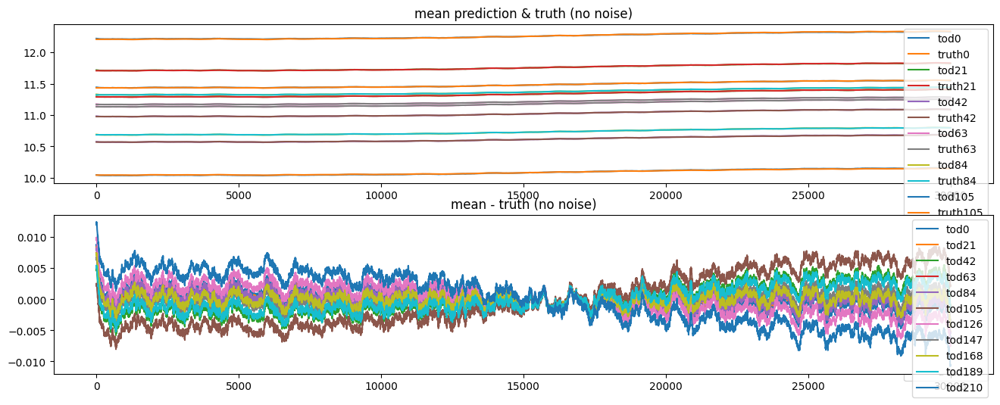

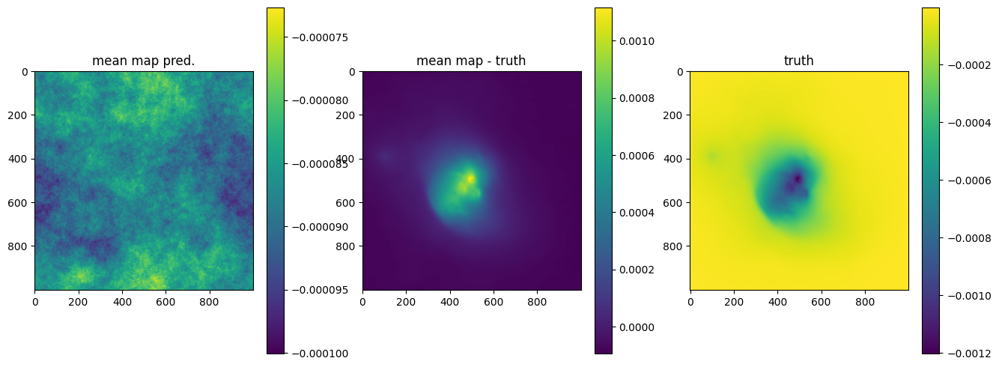

OPTIMIZE_KL: Starting 0008
SL: Iteration 0 ⛰:+3.0061e+22 Δ⛰:inf ➽:1.0322e+01
SL: Iteration 1 ⛰:+3.5688e+18 Δ⛰:3.0057e+22 ➽:1.0322e+01
SL: Iteration 2 ⛰:+2.6827e+17 Δ⛰:3.3005e+18 ➽:1.0322e+01
SL: Iteration 3 ⛰:+2.5531e+17 Δ⛰:1.2958e+16 ➽:1.0322e+01
SL: Iteration 4 ⛰:+1.5836e+17 Δ⛰:9.6955e+16 ➽:1.0322e+01
SL: Iteration 5 ⛰:+1.0966e+17 Δ⛰:4.8696e+16 ➽:1.0322e+01
SL: Iteration 6 ⛰:+6.8609e+16 Δ⛰:4.1052e+16 ➽:1.0322e+01
SL: Iteration 7 ⛰:+6.0012e+16 Δ⛰:8.5966e+15 ➽:1.0322e+01
SL: Iteration 8 ⛰:+4.6379e+16 Δ⛰:1.3633e+16 ➽:1.0322e+01
SL: Iteration 9 ⛰:+3.0331e+16 Δ⛰:1.6048e+16 ➽:1.0322e+01
SL: Iteration 10 ⛰:+3.0276e+16 Δ⛰:5.4562e+13 ➽:1.0322e+01
SL: Iteration 11 ⛰:+3.0256e+16 Δ⛰:2.0446e+13 ➽:1.0322e+01
SL: Iteration 12 ⛰:+2.7099e+16 Δ⛰:3.1572e+15 ➽:1.0322e+01
SL: Iteration 13 ⛰:+2.0627e+16 Δ⛰:6.4721e+15 ➽:1.0322e+01
SL: Iteration 14 ⛰:+2.0626e+16 Δ⛰:2.5406e+11 ➽:1.0322e+01
SL: Iteration 15 ⛰:+1.6279e+16 Δ⛰:4.3470e+15 ➽:1.0322e+01
SL: Iteration 16 ⛰:+1.3654e+16 Δ⛰:2.6256e+15 ➽:1.0322e+01
SL: 

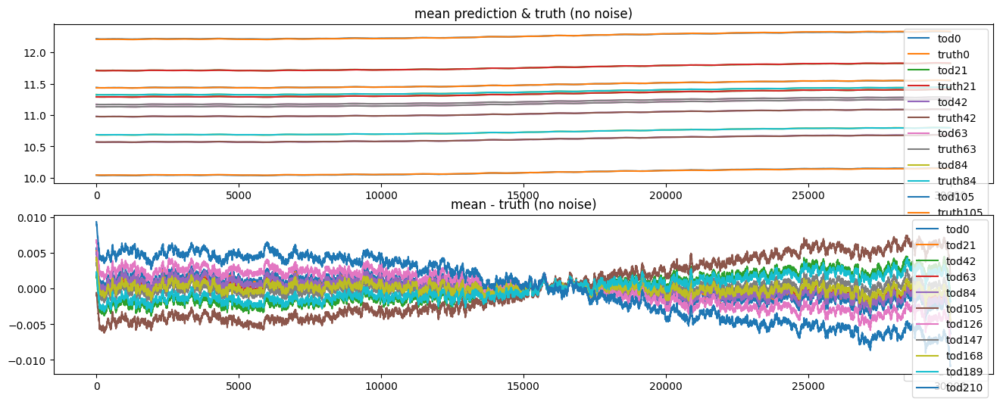

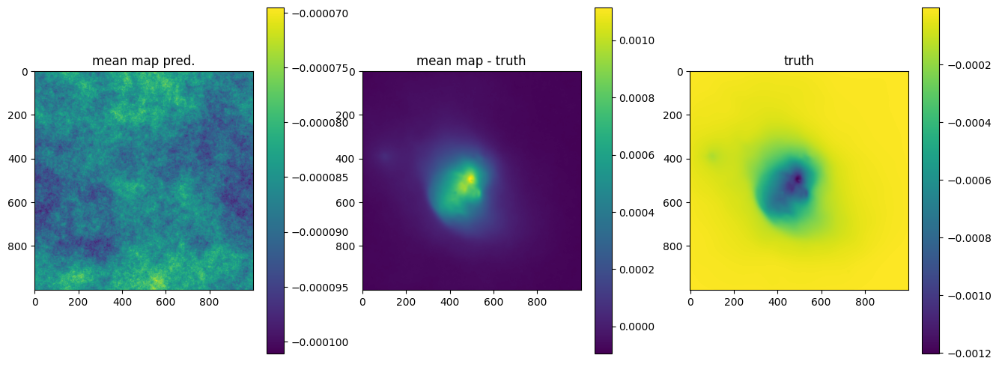

OPTIMIZE_KL: Starting 0009
SL: Iteration 0 ⛰:+3.3050e+22 Δ⛰:inf ➽:1.0322e+01
SL: Iteration 1 ⛰:+6.4905e+17 Δ⛰:3.3050e+22 ➽:1.0322e+01
SL: Iteration 2 ⛰:+3.1436e+17 Δ⛰:3.3469e+17 ➽:1.0322e+01
SL: Iteration 3 ⛰:+2.8091e+17 Δ⛰:3.3444e+16 ➽:1.0322e+01
SL: Iteration 4 ⛰:+1.6643e+17 Δ⛰:1.1448e+17 ➽:1.0322e+01
SL: Iteration 5 ⛰:+1.0307e+17 Δ⛰:6.3363e+16 ➽:1.0322e+01
SL: Iteration 6 ⛰:+6.9261e+16 Δ⛰:3.3807e+16 ➽:1.0322e+01
SL: Iteration 7 ⛰:+4.9535e+16 Δ⛰:1.9726e+16 ➽:1.0322e+01
SL: Iteration 8 ⛰:+4.2852e+16 Δ⛰:6.6830e+15 ➽:1.0322e+01
SL: Iteration 9 ⛰:+2.7957e+16 Δ⛰:1.4895e+16 ➽:1.0322e+01
SL: Iteration 10 ⛰:+2.7934e+16 Δ⛰:2.2706e+13 ➽:1.0322e+01
SL: Iteration 11 ⛰:+2.4186e+16 Δ⛰:3.7486e+15 ➽:1.0322e+01
SL: Iteration 12 ⛰:+2.4007e+16 Δ⛰:1.7911e+14 ➽:1.0322e+01
SL: Iteration 13 ⛰:+1.8815e+16 Δ⛰:5.1911e+15 ➽:1.0322e+01
SL: Iteration 14 ⛰:+1.8814e+16 Δ⛰:1.8587e+12 ➽:1.0322e+01
SL: Iteration 15 ⛰:+1.4875e+16 Δ⛰:3.9384e+15 ➽:1.0322e+01
SL: Iteration 16 ⛰:+1.1551e+16 Δ⛰:3.3240e+15 ➽:1.0322e+01
SL: 

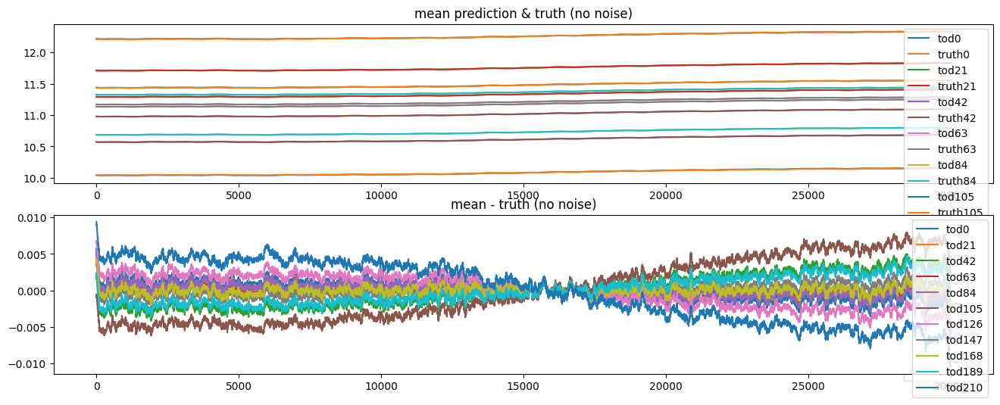

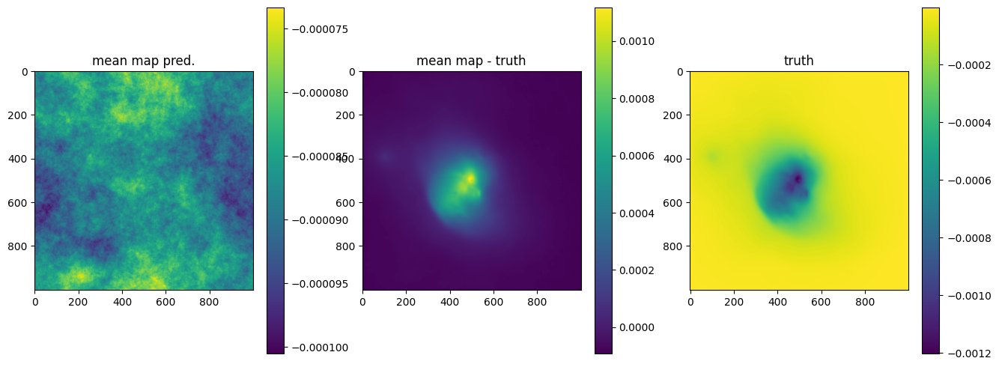

OPTIMIZE_KL: Starting 0010
SL: Iteration 0 ⛰:+3.1078e+22 Δ⛰:inf ➽:1.0322e+01
SL: Iteration 1 ⛰:+1.5746e+18 Δ⛰:3.1076e+22 ➽:1.0322e+01
SL: Iteration 2 ⛰:+6.7324e+17 Δ⛰:9.0141e+17 ➽:1.0322e+01
SL: Iteration 3 ⛰:+4.8788e+17 Δ⛰:1.8536e+17 ➽:1.0322e+01
SL: Iteration 4 ⛰:+2.0368e+17 Δ⛰:2.8420e+17 ➽:1.0322e+01
SL: Iteration 5 ⛰:+1.2317e+17 Δ⛰:8.0509e+16 ➽:1.0322e+01
SL: Iteration 6 ⛰:+8.6412e+16 Δ⛰:3.6761e+16 ➽:1.0322e+01
SL: Iteration 7 ⛰:+5.6680e+16 Δ⛰:2.9732e+16 ➽:1.0322e+01
SL: Iteration 8 ⛰:+3.9933e+16 Δ⛰:1.6746e+16 ➽:1.0322e+01
SL: Iteration 9 ⛰:+3.2053e+16 Δ⛰:7.8802e+15 ➽:1.0322e+01
SL: Iteration 10 ⛰:+3.1874e+16 Δ⛰:1.7941e+14 ➽:1.0322e+01
SL: Iteration 11 ⛰:+3.1640e+16 Δ⛰:2.3348e+14 ➽:1.0322e+01
SL: Iteration 12 ⛰:+2.5078e+16 Δ⛰:6.5624e+15 ➽:1.0322e+01
SL: Iteration 13 ⛰:+2.0938e+16 Δ⛰:4.1396e+15 ➽:1.0322e+01
SL: Iteration 14 ⛰:+2.0935e+16 Δ⛰:3.8073e+12 ➽:1.0322e+01
SL: Iteration 15 ⛰:+1.6678e+16 Δ⛰:4.2566e+15 ➽:1.0322e+01
SL: Iteration 16 ⛰:+1.2331e+16 Δ⛰:4.3468e+15 ➽:1.0322e+01
SL: 

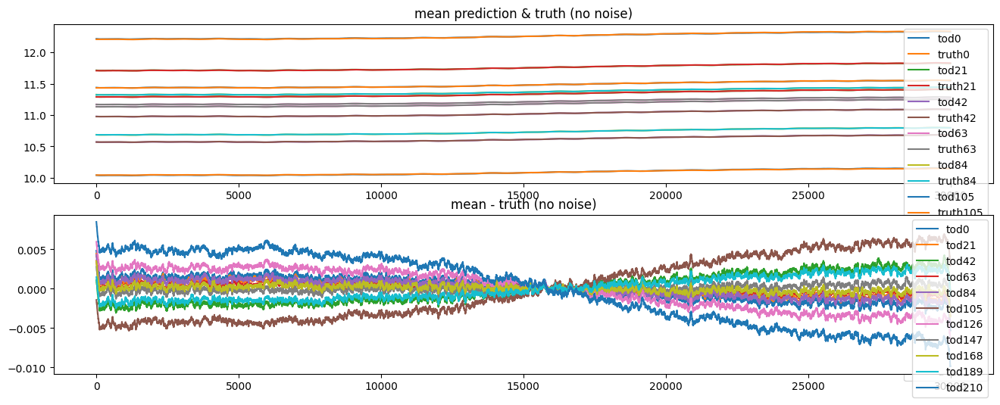

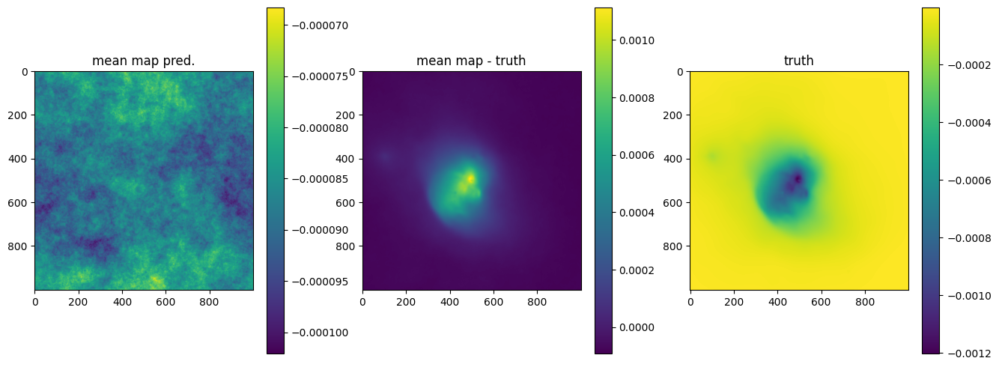

OPTIMIZE_KL: Starting 0011
SL: Iteration 0 ⛰:+2.9056e+22 Δ⛰:inf ➽:1.0322e+01
SL: Iteration 1 ⛰:+1.7538e+18 Δ⛰:2.9054e+22 ➽:1.0322e+01
SL: Iteration 2 ⛰:+8.7640e+17 Δ⛰:8.7744e+17 ➽:1.0322e+01
SL: Iteration 3 ⛰:+7.0683e+17 Δ⛰:1.6956e+17 ➽:1.0322e+01
SL: Iteration 4 ⛰:+2.5896e+17 Δ⛰:4.4788e+17 ➽:1.0322e+01
SL: Iteration 5 ⛰:+1.2564e+17 Δ⛰:1.3332e+17 ➽:1.0322e+01
SL: Iteration 6 ⛰:+5.1037e+16 Δ⛰:7.4602e+16 ➽:1.0322e+01
SL: Iteration 7 ⛰:+3.9702e+16 Δ⛰:1.1335e+16 ➽:1.0322e+01
SL: Iteration 8 ⛰:+3.8084e+16 Δ⛰:1.6182e+15 ➽:1.0322e+01
SL: Iteration 9 ⛰:+1.8799e+16 Δ⛰:1.9285e+16 ➽:1.0322e+01
SL: Iteration 10 ⛰:+1.8794e+16 Δ⛰:4.8547e+12 ➽:1.0322e+01
SL: Iteration 11 ⛰:+1.8791e+16 Δ⛰:3.1521e+12 ➽:1.0322e+01
SL: Iteration 12 ⛰:+1.5610e+16 Δ⛰:3.1801e+15 ➽:1.0322e+01
SL: Iteration 13 ⛰:+1.2192e+16 Δ⛰:3.4185e+15 ➽:1.0322e+01
SL: Iteration 14 ⛰:+1.2191e+16 Δ⛰:1.0508e+12 ➽:1.0322e+01
SL: Iteration 15 ⛰:+1.0007e+16 Δ⛰:2.1840e+15 ➽:1.0322e+01
SL: Iteration 16 ⛰:+7.8513e+15 Δ⛰:2.1556e+15 ➽:1.0322e+01
SL: 

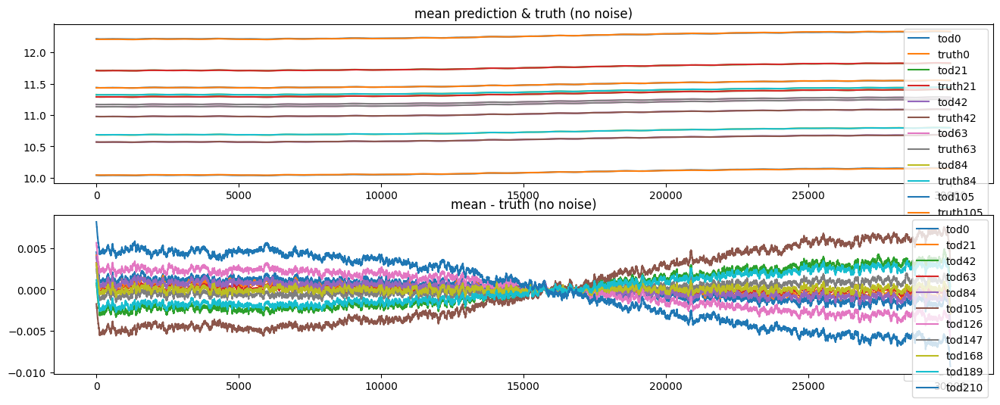

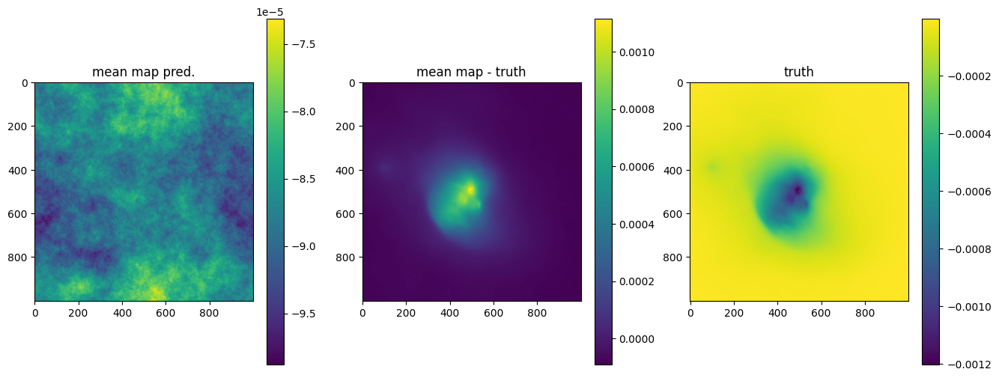

OPTIMIZE_KL: Starting 0012
SL: Iteration 0 ⛰:+3.2412e+22 Δ⛰:inf ➽:1.0322e+01
SL: Iteration 1 ⛰:+2.0463e+19 Δ⛰:3.2392e+22 ➽:1.0322e+01
SL: Iteration 2 ⛰:+4.4647e+17 Δ⛰:2.0017e+19 ➽:1.0322e+01
SL: Iteration 3 ⛰:+1.7096e+17 Δ⛰:2.7551e+17 ➽:1.0322e+01
SL: Iteration 4 ⛰:+1.5573e+17 Δ⛰:1.5233e+16 ➽:1.0322e+01
SL: Iteration 5 ⛰:+7.3954e+16 Δ⛰:8.1775e+16 ➽:1.0322e+01
SL: Iteration 6 ⛰:+4.9432e+16 Δ⛰:2.4522e+16 ➽:1.0322e+01
SL: Iteration 7 ⛰:+4.5428e+16 Δ⛰:4.0034e+15 ➽:1.0322e+01
SL: Iteration 8 ⛰:+3.0442e+16 Δ⛰:1.4986e+16 ➽:1.0322e+01
SL: Iteration 9 ⛰:+2.3025e+16 Δ⛰:7.4173e+15 ➽:1.0322e+01
SL: Iteration 10 ⛰:+2.2922e+16 Δ⛰:1.0312e+14 ➽:1.0322e+01
SL: Iteration 11 ⛰:+2.2468e+16 Δ⛰:4.5366e+14 ➽:1.0322e+01
SL: Iteration 12 ⛰:+1.9435e+16 Δ⛰:3.0325e+15 ➽:1.0322e+01
SL: Iteration 13 ⛰:+1.6290e+16 Δ⛰:3.1450e+15 ➽:1.0322e+01
SL: Iteration 14 ⛰:+1.6286e+16 Δ⛰:4.4025e+12 ➽:1.0322e+01
SL: Iteration 15 ⛰:+1.2793e+16 Δ⛰:3.4926e+15 ➽:1.0322e+01
SL: Iteration 16 ⛰:+1.0474e+16 Δ⛰:2.3190e+15 ➽:1.0322e+01
SL: 

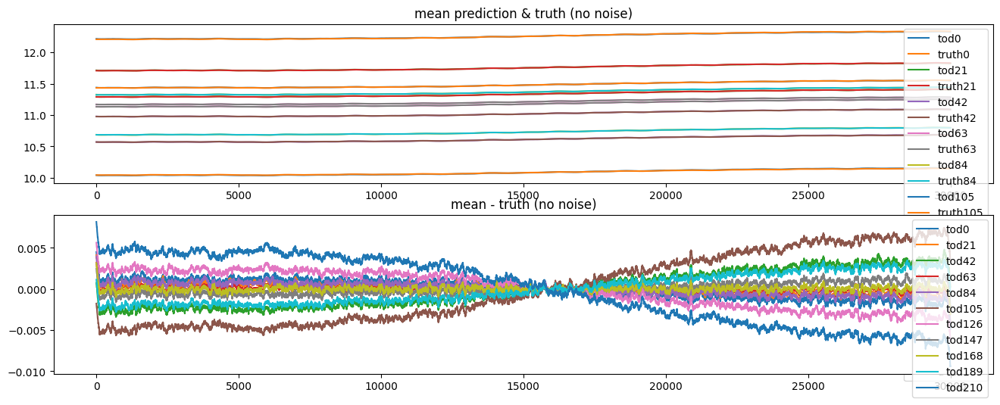

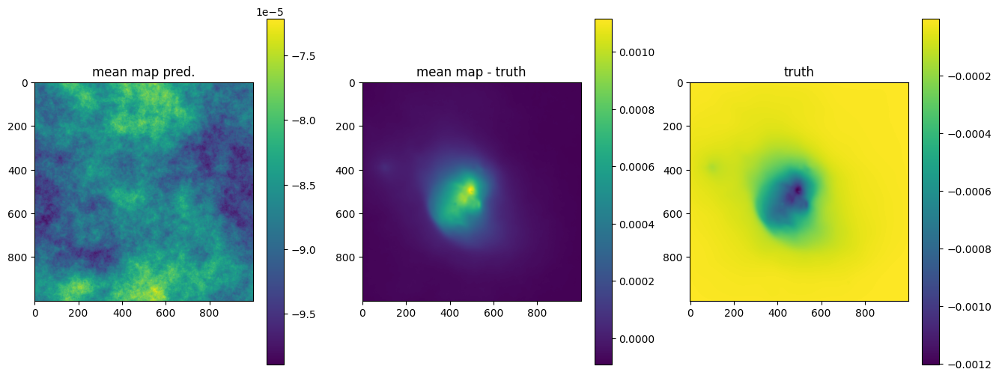

OPTIMIZE_KL: Starting 0013
SL: Iteration 0 ⛰:+3.2955e+22 Δ⛰:inf ➽:1.0322e+01
SL: Iteration 1 ⛰:+1.8505e+18 Δ⛰:3.2953e+22 ➽:1.0322e+01
SL: Iteration 2 ⛰:+1.6234e+18 Δ⛰:2.2706e+17 ➽:1.0322e+01
SL: Iteration 3 ⛰:+1.9295e+17 Δ⛰:1.4304e+18 ➽:1.0322e+01
SL: Iteration 4 ⛰:+1.2523e+17 Δ⛰:6.7721e+16 ➽:1.0322e+01
SL: Iteration 5 ⛰:+7.2958e+16 Δ⛰:5.2269e+16 ➽:1.0322e+01
SL: Iteration 6 ⛰:+6.0649e+16 Δ⛰:1.2309e+16 ➽:1.0322e+01
SL: Iteration 7 ⛰:+4.9186e+16 Δ⛰:1.1463e+16 ➽:1.0322e+01
SL: Iteration 8 ⛰:+3.2524e+16 Δ⛰:1.6662e+16 ➽:1.0322e+01
SL: Iteration 9 ⛰:+2.3419e+16 Δ⛰:9.1045e+15 ➽:1.0322e+01
SL: Iteration 10 ⛰:+2.3244e+16 Δ⛰:1.7561e+14 ➽:1.0322e+01
SL: Iteration 11 ⛰:+2.1631e+16 Δ⛰:1.6124e+15 ➽:1.0322e+01
SL: Iteration 12 ⛰:+1.9937e+16 Δ⛰:1.6948e+15 ➽:1.0322e+01
SL: Iteration 13 ⛰:+1.4069e+16 Δ⛰:5.8674e+15 ➽:1.0322e+01
SL: Iteration 14 ⛰:+1.4066e+16 Δ⛰:3.3505e+12 ➽:1.0322e+01
SL: Iteration 15 ⛰:+1.0104e+16 Δ⛰:3.9622e+15 ➽:1.0322e+01
SL: Iteration 16 ⛰:+8.5731e+15 Δ⛰:1.5304e+15 ➽:1.0322e+01
SL: 

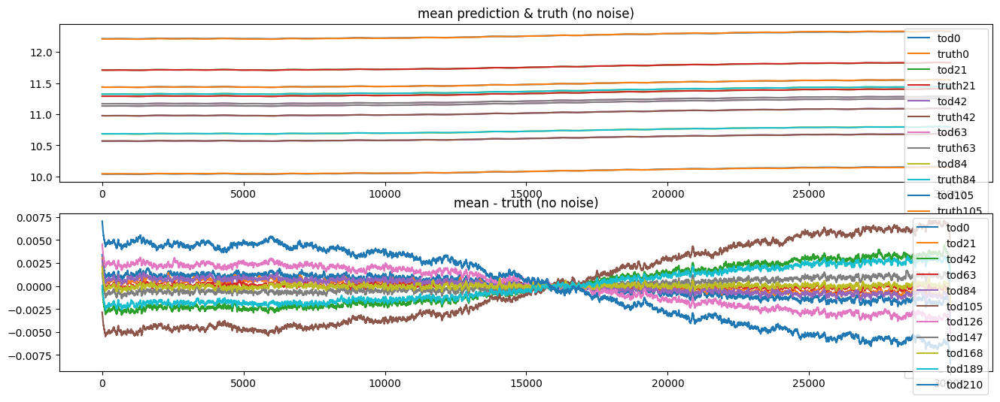

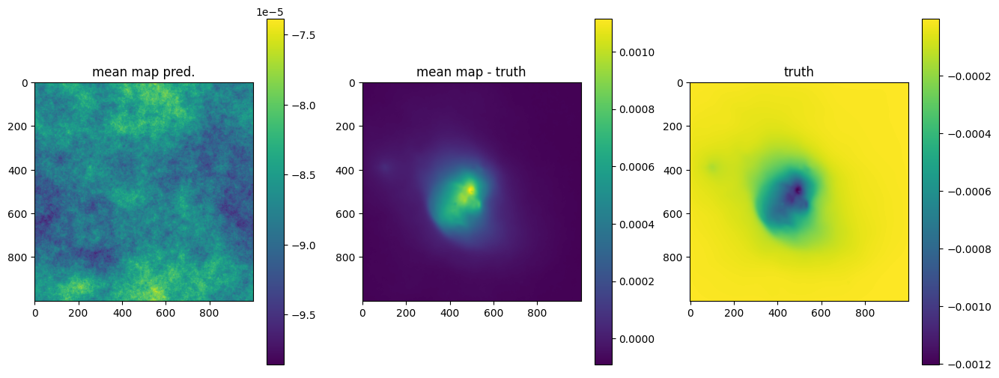

OPTIMIZE_KL: Starting 0014
SL: Iteration 0 ⛰:+3.7261e+22 Δ⛰:inf ➽:1.0322e+01
SL: Iteration 1 ⛰:+7.5313e+19 Δ⛰:3.7186e+22 ➽:1.0322e+01
SL: Iteration 2 ⛰:+3.4613e+18 Δ⛰:7.1852e+19 ➽:1.0322e+01
SL: Iteration 3 ⛰:+3.1815e+17 Δ⛰:3.1431e+18 ➽:1.0322e+01
SL: Iteration 4 ⛰:+1.8004e+17 Δ⛰:1.3811e+17 ➽:1.0322e+01
SL: Iteration 5 ⛰:+1.2284e+17 Δ⛰:5.7205e+16 ➽:1.0322e+01
SL: Iteration 6 ⛰:+6.6094e+16 Δ⛰:5.6744e+16 ➽:1.0322e+01
SL: Iteration 7 ⛰:+4.4464e+16 Δ⛰:2.1630e+16 ➽:1.0322e+01
SL: Iteration 8 ⛰:+2.2349e+16 Δ⛰:2.2115e+16 ➽:1.0322e+01
SL: Iteration 9 ⛰:+1.5527e+16 Δ⛰:6.8220e+15 ➽:1.0322e+01
SL: Iteration 10 ⛰:+1.5502e+16 Δ⛰:2.5059e+13 ➽:1.0322e+01
SL: Iteration 11 ⛰:+1.5165e+16 Δ⛰:3.3627e+14 ➽:1.0322e+01
SL: Iteration 12 ⛰:+1.3284e+16 Δ⛰:1.8810e+15 ➽:1.0322e+01
SL: Iteration 13 ⛰:+1.0364e+16 Δ⛰:2.9204e+15 ➽:1.0322e+01
SL: Iteration 14 ⛰:+1.0363e+16 Δ⛰:8.1946e+11 ➽:1.0322e+01
SL: Iteration 15 ⛰:+6.5574e+15 Δ⛰:3.8058e+15 ➽:1.0322e+01
SL: Iteration 16 ⛰:+5.2861e+15 Δ⛰:1.2713e+15 ➽:1.0322e+01
SL: 

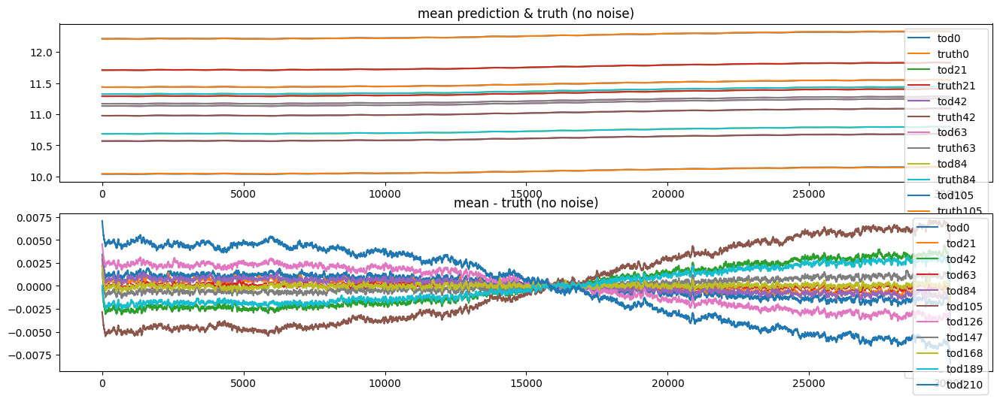

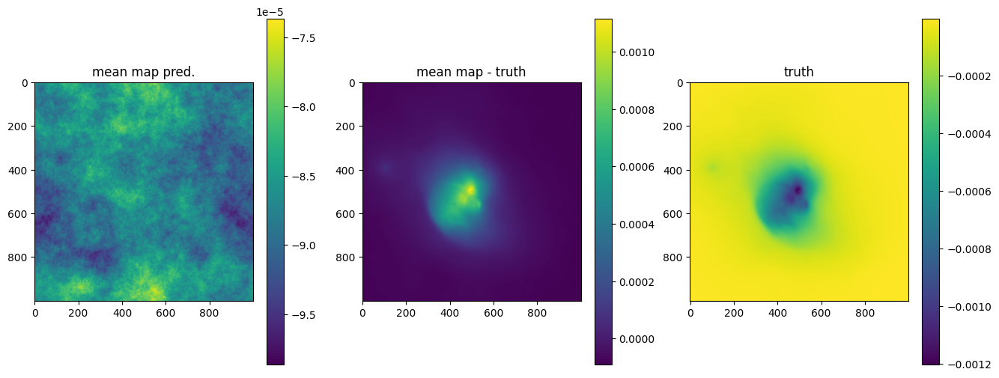

OPTIMIZE_KL: Starting 0015
SL: Iteration 0 ⛰:+3.5051e+22 Δ⛰:inf ➽:1.0322e+01
SL: Iteration 1 ⛰:+1.6321e+19 Δ⛰:3.5035e+22 ➽:1.0322e+01
SL: Iteration 2 ⛰:+1.1403e+18 Δ⛰:1.5181e+19 ➽:1.0322e+01
SL: Iteration 3 ⛰:+3.0396e+17 Δ⛰:8.3639e+17 ➽:1.0322e+01
SL: Iteration 4 ⛰:+2.9436e+17 Δ⛰:9.5907e+15 ➽:1.0322e+01
SL: Iteration 5 ⛰:+1.6535e+17 Δ⛰:1.2901e+17 ➽:1.0322e+01
SL: Iteration 6 ⛰:+6.4863e+16 Δ⛰:1.0049e+17 ➽:1.0322e+01
SL: Iteration 7 ⛰:+3.3317e+16 Δ⛰:3.1547e+16 ➽:1.0322e+01
SL: Iteration 8 ⛰:+2.5342e+16 Δ⛰:7.9747e+15 ➽:1.0322e+01
SL: Iteration 9 ⛰:+1.8023e+16 Δ⛰:7.3188e+15 ➽:1.0322e+01
SL: Iteration 10 ⛰:+1.8017e+16 Δ⛰:6.1932e+12 ➽:1.0322e+01
SL: Iteration 11 ⛰:+1.6742e+16 Δ⛰:1.2747e+15 ➽:1.0322e+01
SL: Iteration 12 ⛰:+1.6614e+16 Δ⛰:1.2855e+14 ➽:1.0322e+01
SL: Iteration 13 ⛰:+1.1906e+16 Δ⛰:4.7076e+15 ➽:1.0322e+01
SL: Iteration 14 ⛰:+1.1906e+16 Δ⛰:4.3259e+11 ➽:1.0322e+01
SL: Iteration 15 ⛰:+8.0016e+15 Δ⛰:3.9043e+15 ➽:1.0322e+01
SL: Iteration 16 ⛰:+6.7877e+15 Δ⛰:1.2139e+15 ➽:1.0322e+01
SL: 

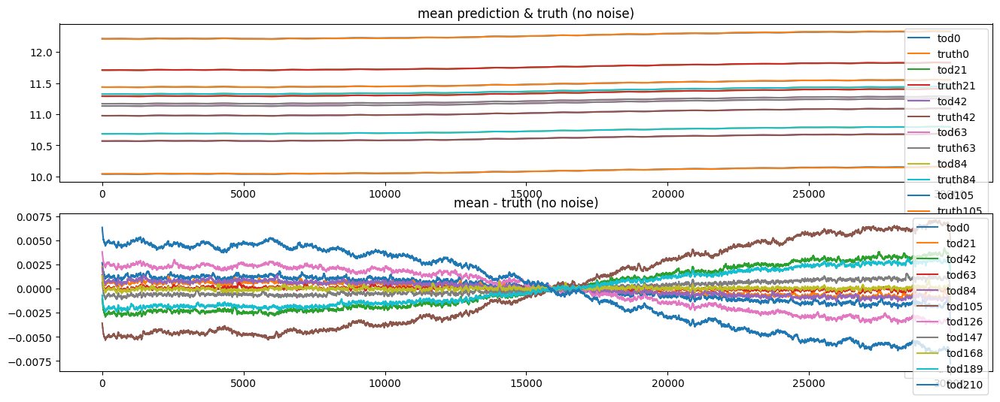

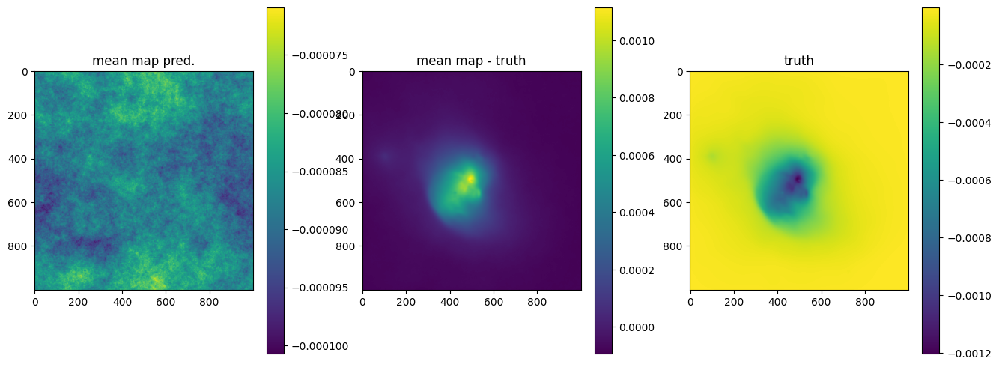

OPTIMIZE_KL: Starting 0016
SL: Iteration 0 ⛰:+3.3988e+22 Δ⛰:inf ➽:1.0322e+01
SL: Iteration 1 ⛰:+7.7314e+19 Δ⛰:3.3911e+22 ➽:1.0322e+01
SL: Iteration 2 ⛰:+2.3554e+17 Δ⛰:7.7078e+19 ➽:1.0322e+01
SL: Iteration 3 ⛰:+2.3405e+17 Δ⛰:1.4910e+15 ➽:1.0322e+01
SL: Iteration 4 ⛰:+1.7476e+17 Δ⛰:5.9289e+16 ➽:1.0322e+01
SL: Iteration 5 ⛰:+1.1656e+17 Δ⛰:5.8204e+16 ➽:1.0322e+01
SL: Iteration 6 ⛰:+4.4348e+16 Δ⛰:7.2209e+16 ➽:1.0322e+01
SL: Iteration 7 ⛰:+2.6989e+16 Δ⛰:1.7359e+16 ➽:1.0322e+01
SL: Iteration 8 ⛰:+2.4864e+16 Δ⛰:2.1246e+15 ➽:1.0322e+01
SL: Iteration 9 ⛰:+1.0453e+16 Δ⛰:1.4411e+16 ➽:1.0322e+01
SL: Iteration 10 ⛰:+9.8107e+15 Δ⛰:6.4223e+14 ➽:1.0322e+01
SL: Iteration 11 ⛰:+9.8104e+15 Δ⛰:3.3513e+11 ➽:1.0322e+01
SL: Iteration 12 ⛰:+7.4465e+15 Δ⛰:2.3639e+15 ➽:1.0322e+01
SL: Iteration 13 ⛰:+6.7106e+15 Δ⛰:7.3596e+14 ➽:1.0322e+01
SL: Iteration 14 ⛰:+6.7105e+15 Δ⛰:8.6415e+10 ➽:1.0322e+01
SL: Iteration 15 ⛰:+4.9603e+15 Δ⛰:1.7502e+15 ➽:1.0322e+01
SL: Iteration 16 ⛰:+4.5846e+15 Δ⛰:3.7568e+14 ➽:1.0322e+01
SL: 

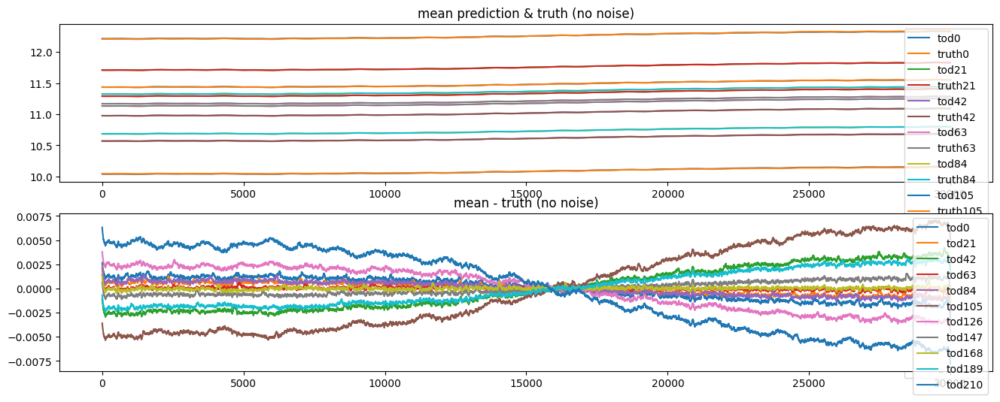

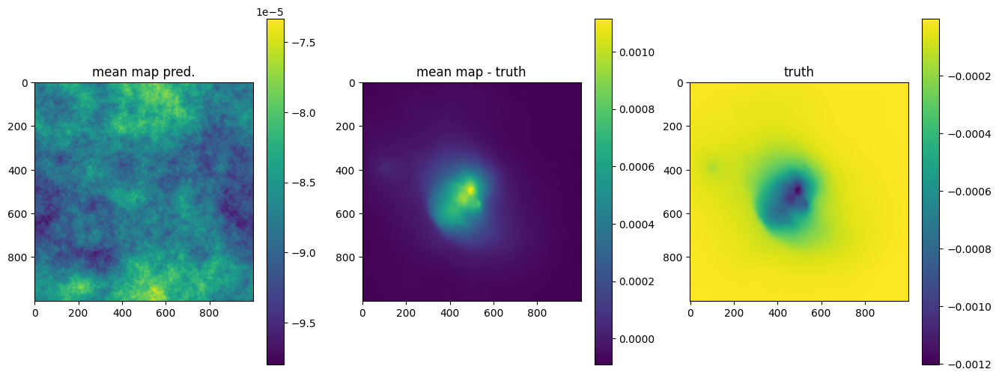

OPTIMIZE_KL: Starting 0017
SL: Iteration 0 ⛰:+3.2692e+22 Δ⛰:inf ➽:1.0322e+01
SL: Iteration 1 ⛰:+5.5549e+18 Δ⛰:3.2687e+22 ➽:1.0322e+01
SL: Iteration 2 ⛰:+1.5801e+17 Δ⛰:5.3969e+18 ➽:1.0322e+01
SL: Iteration 3 ⛰:+1.5761e+17 Δ⛰:4.0046e+14 ➽:1.0322e+01
SL: Iteration 4 ⛰:+1.3859e+17 Δ⛰:1.9020e+16 ➽:1.0322e+01
SL: Iteration 5 ⛰:+5.2121e+16 Δ⛰:8.6472e+16 ➽:1.0322e+01
SL: Iteration 6 ⛰:+4.1016e+16 Δ⛰:1.1105e+16 ➽:1.0322e+01
SL: Iteration 7 ⛰:+3.1998e+16 Δ⛰:9.0175e+15 ➽:1.0322e+01
SL: Iteration 8 ⛰:+2.5716e+16 Δ⛰:6.2817e+15 ➽:1.0322e+01
SL: Iteration 9 ⛰:+1.7639e+16 Δ⛰:8.0774e+15 ➽:1.0322e+01
SL: Iteration 10 ⛰:+1.7598e+16 Δ⛰:4.1448e+13 ➽:1.0322e+01
SL: Iteration 11 ⛰:+1.7538e+16 Δ⛰:5.9795e+13 ➽:1.0322e+01
SL: Iteration 12 ⛰:+1.0652e+16 Δ⛰:6.8863e+15 ➽:1.0322e+01
SL: Iteration 13 ⛰:+7.4355e+15 Δ⛰:3.2161e+15 ➽:1.0322e+01
SL: Iteration 14 ⛰:+7.4354e+15 Δ⛰:1.2331e+11 ➽:1.0322e+01
SL: Iteration 15 ⛰:+5.3306e+15 Δ⛰:2.1048e+15 ➽:1.0322e+01
SL: Iteration 16 ⛰:+4.7089e+15 Δ⛰:6.2170e+14 ➽:1.0322e+01
SL: 

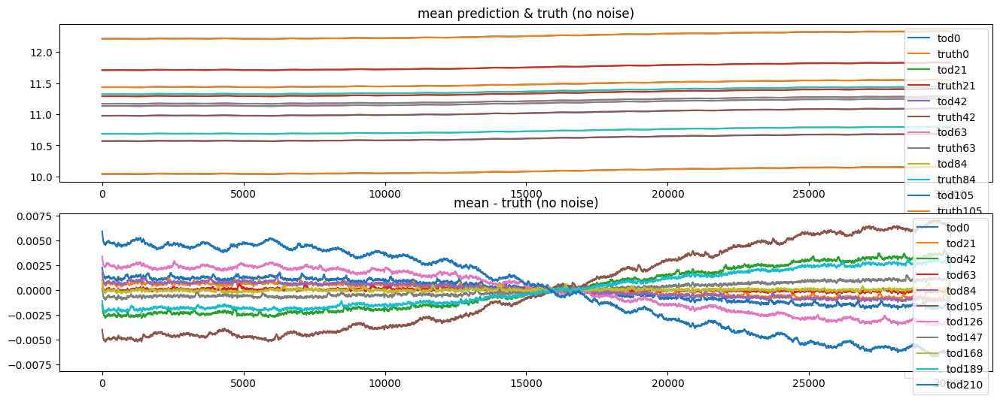

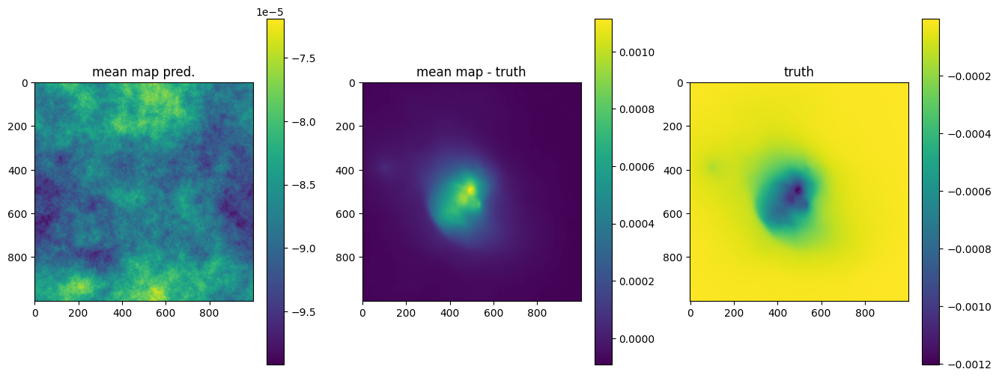

OPTIMIZE_KL: Starting 0018
SL: Iteration 0 ⛰:+3.2082e+22 Δ⛰:inf ➽:1.0322e+01
SL: Iteration 1 ⛰:+4.0498e+18 Δ⛰:3.2078e+22 ➽:1.0322e+01
SL: Iteration 2 ⛰:+6.4094e+17 Δ⛰:3.4089e+18 ➽:1.0322e+01
SL: Iteration 3 ⛰:+3.6355e+17 Δ⛰:2.7739e+17 ➽:1.0322e+01
SL: Iteration 4 ⛰:+1.4144e+17 Δ⛰:2.2211e+17 ➽:1.0322e+01
SL: Iteration 5 ⛰:+6.9430e+16 Δ⛰:7.2013e+16 ➽:1.0322e+01
SL: Iteration 6 ⛰:+3.2446e+16 Δ⛰:3.6983e+16 ➽:1.0322e+01
SL: Iteration 7 ⛰:+3.1555e+16 Δ⛰:8.9151e+14 ➽:1.0322e+01
SL: Iteration 8 ⛰:+1.7203e+16 Δ⛰:1.4352e+16 ➽:1.0322e+01
SL: Iteration 9 ⛰:+1.2661e+16 Δ⛰:4.5420e+15 ➽:1.0322e+01
SL: Iteration 10 ⛰:+1.2651e+16 Δ⛰:1.0475e+13 ➽:1.0322e+01
SL: Iteration 11 ⛰:+1.2525e+16 Δ⛰:1.2602e+14 ➽:1.0322e+01
SL: Iteration 12 ⛰:+9.0068e+15 Δ⛰:3.5181e+15 ➽:1.0322e+01
SL: Iteration 13 ⛰:+6.1120e+15 Δ⛰:2.8947e+15 ➽:1.0322e+01
SL: Iteration 14 ⛰:+6.1116e+15 Δ⛰:3.9685e+11 ➽:1.0322e+01
SL: Iteration 15 ⛰:+4.3492e+15 Δ⛰:1.7624e+15 ➽:1.0322e+01
SL: Iteration 16 ⛰:+4.2730e+15 Δ⛰:7.6237e+13 ➽:1.0322e+01
SL: 

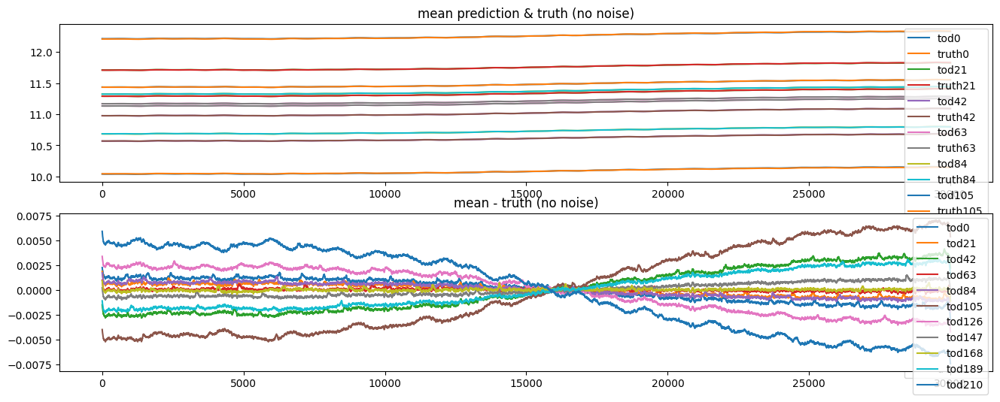

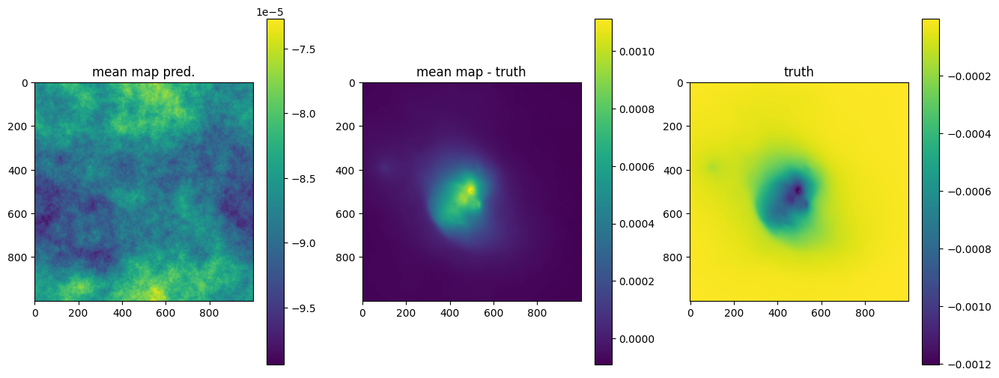

OPTIMIZE_KL: Starting 0019
SL: Iteration 0 ⛰:+3.8343e+22 Δ⛰:inf ➽:1.0322e+01
SL: Iteration 1 ⛰:+1.1228e+19 Δ⛰:3.8331e+22 ➽:1.0322e+01
SL: Iteration 2 ⛰:+3.3502e+17 Δ⛰:1.0893e+19 ➽:1.0322e+01
SL: Iteration 3 ⛰:+3.1492e+17 Δ⛰:2.0104e+16 ➽:1.0322e+01
SL: Iteration 4 ⛰:+9.9741e+16 Δ⛰:2.1518e+17 ➽:1.0322e+01
SL: Iteration 5 ⛰:+5.0878e+16 Δ⛰:4.8863e+16 ➽:1.0322e+01
SL: Iteration 6 ⛰:+2.6261e+16 Δ⛰:2.4618e+16 ➽:1.0322e+01
SL: Iteration 7 ⛰:+2.1476e+16 Δ⛰:4.7847e+15 ➽:1.0322e+01
SL: Iteration 8 ⛰:+1.4371e+16 Δ⛰:7.1052e+15 ➽:1.0322e+01
SL: Iteration 9 ⛰:+1.1276e+16 Δ⛰:3.0945e+15 ➽:1.0322e+01
SL: Iteration 10 ⛰:+1.1265e+16 Δ⛰:1.1141e+13 ➽:1.0322e+01
SL: Iteration 11 ⛰:+1.1258e+16 Δ⛰:6.7440e+12 ➽:1.0322e+01
SL: Iteration 12 ⛰:+9.4435e+15 Δ⛰:1.8148e+15 ➽:1.0322e+01
SL: Iteration 13 ⛰:+5.9828e+15 Δ⛰:3.4606e+15 ➽:1.0322e+01
SL: Iteration 14 ⛰:+5.9826e+15 Δ⛰:2.3263e+11 ➽:1.0322e+01
SL: Iteration 15 ⛰:+4.3217e+15 Δ⛰:1.6609e+15 ➽:1.0322e+01
SL: Iteration 16 ⛰:+4.3129e+15 Δ⛰:8.7580e+12 ➽:1.0322e+01
SL: 

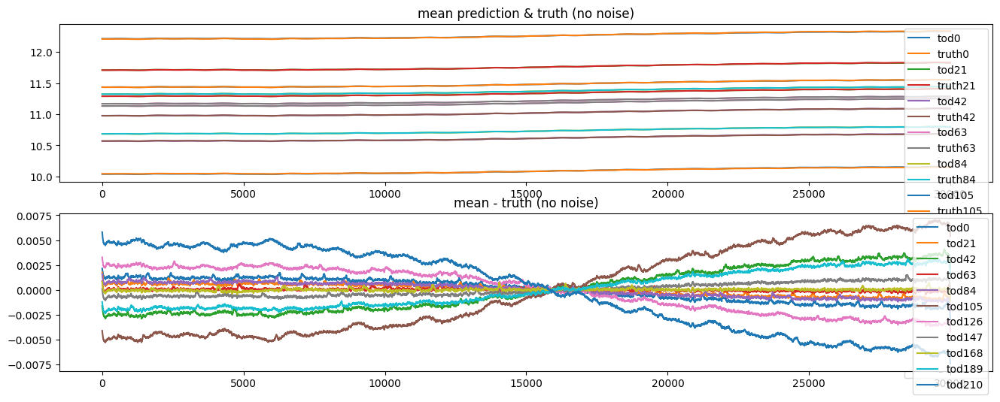

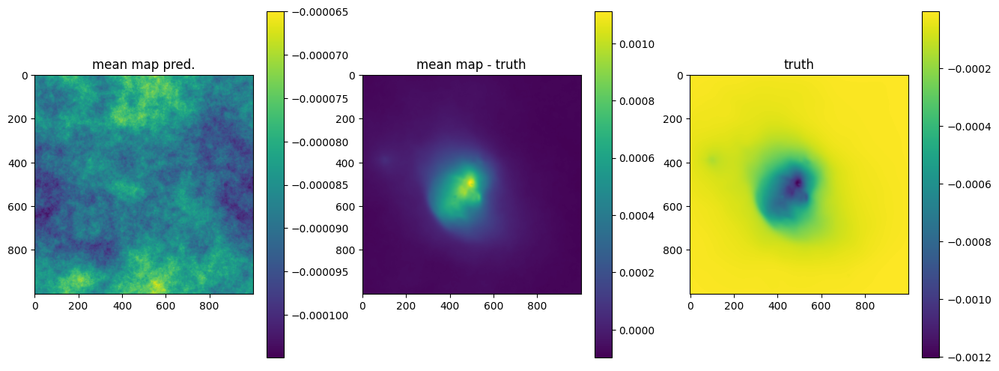

OPTIMIZE_KL: Starting 0020
SL: Iteration 0 ⛰:+3.4253e+22 Δ⛰:inf ➽:1.0322e+01
SL: Iteration 1 ⛰:+2.6577e+18 Δ⛰:3.4250e+22 ➽:1.0322e+01
SL: Iteration 2 ⛰:+4.7462e+17 Δ⛰:2.1831e+18 ➽:1.0322e+01
SL: Iteration 3 ⛰:+4.4898e+17 Δ⛰:2.5639e+16 ➽:1.0322e+01
SL: Iteration 4 ⛰:+1.5193e+17 Δ⛰:2.9705e+17 ➽:1.0322e+01
SL: Iteration 5 ⛰:+5.1533e+16 Δ⛰:1.0040e+17 ➽:1.0322e+01
SL: Iteration 6 ⛰:+3.2514e+16 Δ⛰:1.9019e+16 ➽:1.0322e+01
SL: Iteration 7 ⛰:+3.2184e+16 Δ⛰:3.3013e+14 ➽:1.0322e+01
SL: Iteration 8 ⛰:+2.1833e+16 Δ⛰:1.0351e+16 ➽:1.0322e+01
SL: Iteration 9 ⛰:+1.5310e+16 Δ⛰:6.5225e+15 ➽:1.0322e+01
SL: Iteration 10 ⛰:+1.5298e+16 Δ⛰:1.2312e+13 ➽:1.0322e+01
SL: Iteration 11 ⛰:+1.5294e+16 Δ⛰:4.2059e+12 ➽:1.0322e+01
SL: Iteration 12 ⛰:+1.1860e+16 Δ⛰:3.4332e+15 ➽:1.0322e+01
SL: Iteration 13 ⛰:+6.0687e+15 Δ⛰:5.7918e+15 ➽:1.0322e+01
SL: Iteration 14 ⛰:+6.0672e+15 Δ⛰:1.5295e+12 ➽:1.0322e+01
SL: Iteration 15 ⛰:+5.0003e+15 Δ⛰:1.0669e+15 ➽:1.0322e+01
SL: Iteration 16 ⛰:+3.9348e+15 Δ⛰:1.0655e+15 ➽:1.0322e+01
SL: 

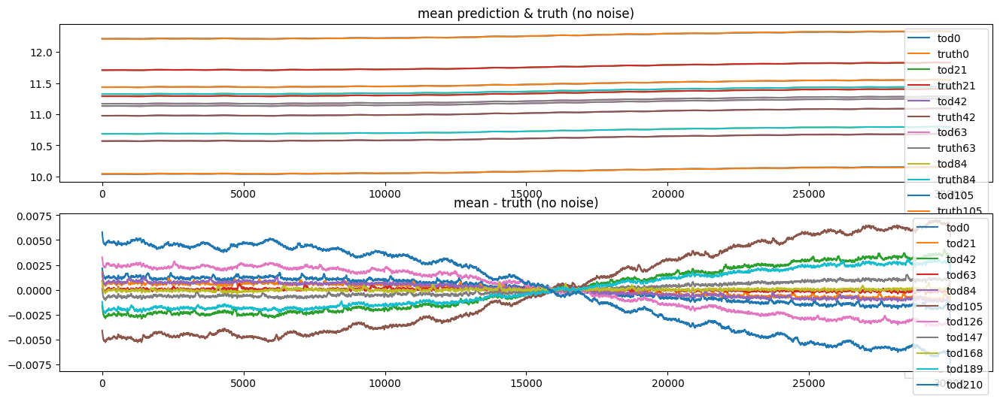

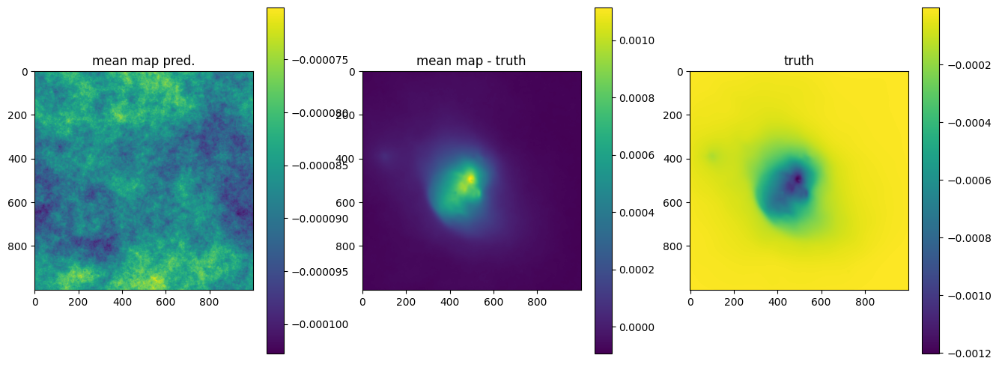

OPTIMIZE_KL: Starting 0021
SL: Iteration 0 ⛰:+2.9742e+22 Δ⛰:inf ➽:1.0322e+01
SL: Iteration 1 ⛰:+1.7323e+18 Δ⛰:2.9740e+22 ➽:1.0322e+01
SL: Iteration 2 ⛰:+1.5023e+18 Δ⛰:2.3000e+17 ➽:1.0322e+01
SL: Iteration 3 ⛰:+2.4815e+17 Δ⛰:1.2541e+18 ➽:1.0322e+01
SL: Iteration 4 ⛰:+9.4204e+16 Δ⛰:1.5394e+17 ➽:1.0322e+01
SL: Iteration 5 ⛰:+3.9446e+16 Δ⛰:5.4758e+16 ➽:1.0322e+01
SL: Iteration 6 ⛰:+2.7635e+16 Δ⛰:1.1811e+16 ➽:1.0322e+01
SL: Iteration 7 ⛰:+2.2219e+16 Δ⛰:5.4158e+15 ➽:1.0322e+01
SL: Iteration 8 ⛰:+1.1980e+16 Δ⛰:1.0239e+16 ➽:1.0322e+01
SL: Iteration 9 ⛰:+8.5914e+15 Δ⛰:3.3890e+15 ➽:1.0322e+01
SL: Iteration 10 ⛰:+8.5329e+15 Δ⛰:5.8553e+13 ➽:1.0322e+01
SL: Iteration 11 ⛰:+8.0944e+15 Δ⛰:4.3847e+14 ➽:1.0322e+01
SL: Iteration 12 ⛰:+7.6730e+15 Δ⛰:4.2146e+14 ➽:1.0322e+01
SL: Iteration 13 ⛰:+5.2815e+15 Δ⛰:2.3915e+15 ➽:1.0322e+01
SL: Iteration 14 ⛰:+5.2814e+15 Δ⛰:5.7655e+10 ➽:1.0322e+01
SL: Iteration 15 ⛰:+3.9641e+15 Δ⛰:1.3173e+15 ➽:1.0322e+01
SL: Iteration 16 ⛰:+3.9534e+15 Δ⛰:1.0753e+13 ➽:1.0322e+01
SL: 

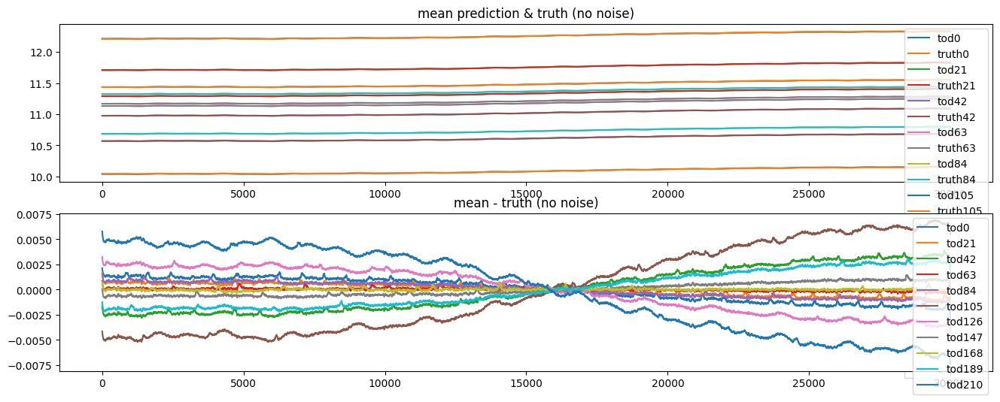

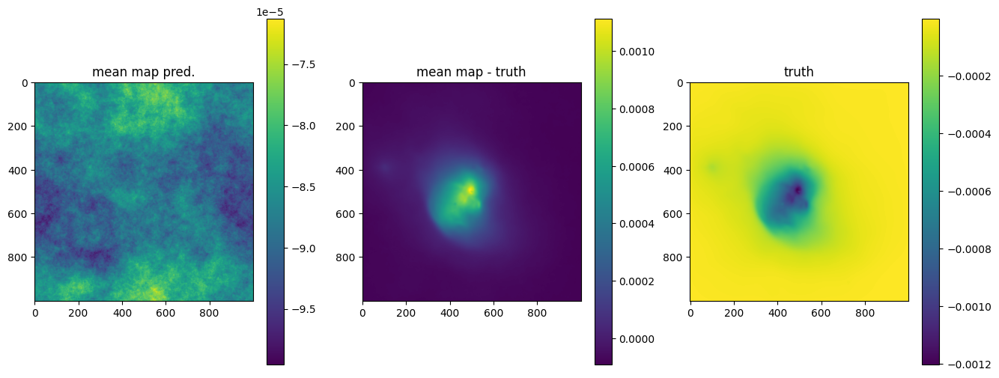

OPTIMIZE_KL: Starting 0022
SL: Iteration 0 ⛰:+2.7345e+22 Δ⛰:inf ➽:1.0322e+01
SL: Iteration 1 ⛰:+5.6208e+17 Δ⛰:2.7344e+22 ➽:1.0322e+01
SL: Iteration 2 ⛰:+4.4855e+17 Δ⛰:1.1353e+17 ➽:1.0322e+01
SL: Iteration 3 ⛰:+3.1508e+17 Δ⛰:1.3347e+17 ➽:1.0322e+01
SL: Iteration 4 ⛰:+1.3100e+17 Δ⛰:1.8408e+17 ➽:1.0322e+01
SL: Iteration 5 ⛰:+5.1815e+16 Δ⛰:7.9182e+16 ➽:1.0322e+01
SL: Iteration 6 ⛰:+4.0764e+16 Δ⛰:1.1051e+16 ➽:1.0322e+01
SL: Iteration 7 ⛰:+3.1471e+16 Δ⛰:9.2932e+15 ➽:1.0322e+01
SL: Iteration 8 ⛰:+1.0898e+16 Δ⛰:2.0573e+16 ➽:1.0322e+01
SL: Iteration 9 ⛰:+8.9228e+15 Δ⛰:1.9748e+15 ➽:1.0322e+01
SL: Iteration 10 ⛰:+8.8744e+15 Δ⛰:4.8420e+13 ➽:1.0322e+01
SL: Iteration 11 ⛰:+8.3127e+15 Δ⛰:5.6165e+14 ➽:1.0322e+01
SL: Iteration 12 ⛰:+6.8316e+15 Δ⛰:1.4812e+15 ➽:1.0322e+01
SL: Iteration 13 ⛰:+5.3326e+15 Δ⛰:1.4990e+15 ➽:1.0322e+01
SL: Iteration 14 ⛰:+5.3323e+15 Δ⛰:2.6087e+11 ➽:1.0322e+01
SL: Iteration 15 ⛰:+3.7184e+15 Δ⛰:1.6139e+15 ➽:1.0322e+01
SL: Iteration 16 ⛰:+3.7130e+15 Δ⛰:5.3534e+12 ➽:1.0322e+01
SL: 

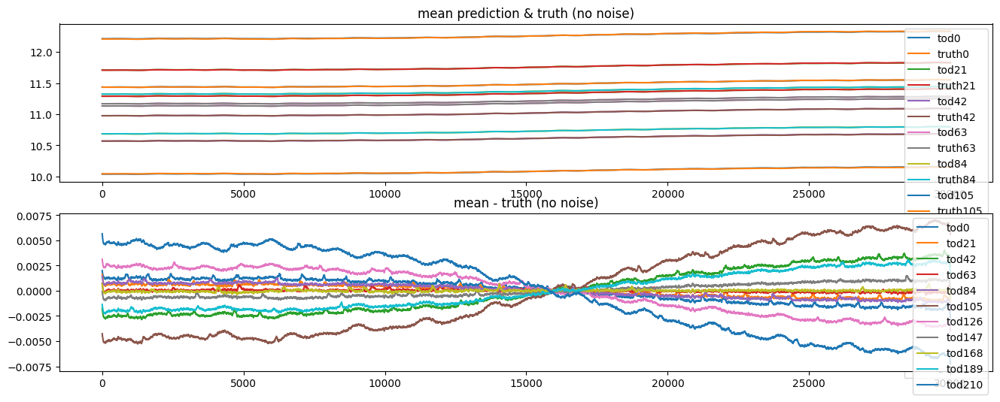

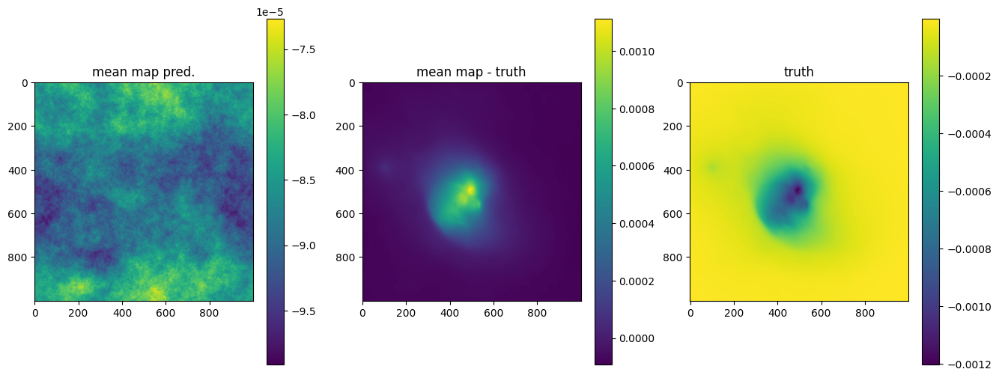

OPTIMIZE_KL: Starting 0023
SL: Iteration 0 ⛰:+3.3832e+22 Δ⛰:inf ➽:1.0322e+01
SL: Iteration 1 ⛰:+4.7852e+18 Δ⛰:3.3827e+22 ➽:1.0322e+01
SL: Iteration 2 ⛰:+2.6207e+17 Δ⛰:4.5231e+18 ➽:1.0322e+01
SL: Iteration 3 ⛰:+2.5529e+17 Δ⛰:6.7847e+15 ➽:1.0322e+01
SL: Iteration 4 ⛰:+1.5906e+17 Δ⛰:9.6222e+16 ➽:1.0322e+01
SL: Iteration 5 ⛰:+8.4322e+16 Δ⛰:7.4741e+16 ➽:1.0322e+01
SL: Iteration 6 ⛰:+2.6427e+16 Δ⛰:5.7895e+16 ➽:1.0322e+01
SL: Iteration 7 ⛰:+2.5671e+16 Δ⛰:7.5582e+14 ➽:1.0322e+01
SL: Iteration 8 ⛰:+1.3747e+16 Δ⛰:1.1925e+16 ➽:1.0322e+01
SL: Iteration 9 ⛰:+1.0910e+16 Δ⛰:2.8366e+15 ➽:1.0322e+01
SL: Iteration 10 ⛰:+1.0901e+16 Δ⛰:8.5297e+12 ➽:1.0322e+01
SL: Iteration 11 ⛰:+1.0857e+16 Δ⛰:4.4654e+13 ➽:1.0322e+01
SL: Iteration 12 ⛰:+6.5652e+15 Δ⛰:4.2916e+15 ➽:1.0322e+01
SL: Iteration 13 ⛰:+4.3176e+15 Δ⛰:2.2476e+15 ➽:1.0322e+01
SL: Iteration 14 ⛰:+4.3173e+15 Δ⛰:2.8501e+11 ➽:1.0322e+01
SL: Iteration 15 ⛰:+3.0951e+15 Δ⛰:1.2222e+15 ➽:1.0322e+01
SL: Iteration 16 ⛰:+2.8847e+15 Δ⛰:2.1039e+14 ➽:1.0322e+01
SL: 

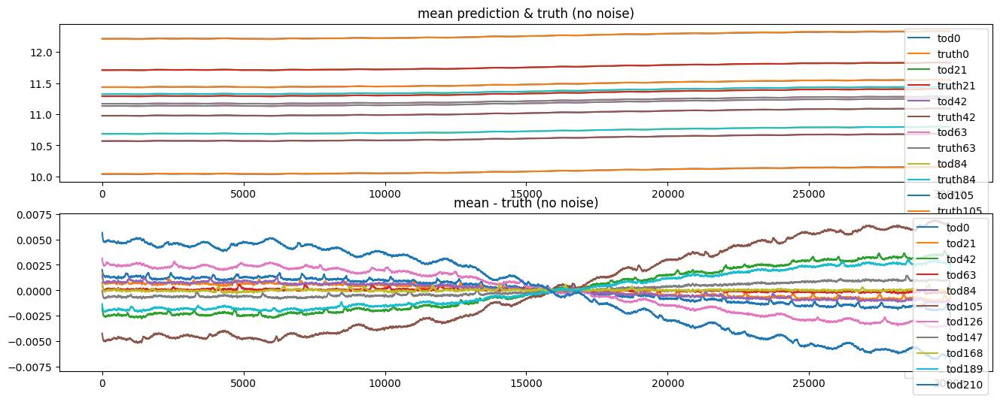

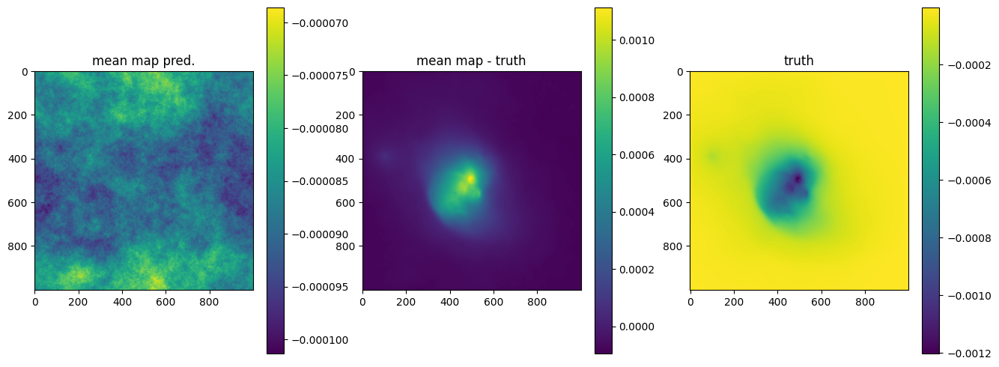

OPTIMIZE_KL: Starting 0024
SL: Iteration 0 ⛰:+3.6695e+22 Δ⛰:inf ➽:1.0322e+01
SL: Iteration 1 ⛰:+4.2948e+18 Δ⛰:3.6691e+22 ➽:1.0322e+01
SL: Iteration 2 ⛰:+2.8511e+18 Δ⛰:1.4438e+18 ➽:1.0322e+01
SL: Iteration 3 ⛰:+7.0739e+17 Δ⛰:2.1437e+18 ➽:1.0322e+01
SL: Iteration 4 ⛰:+2.6500e+17 Δ⛰:4.4239e+17 ➽:1.0322e+01
SL: Iteration 5 ⛰:+2.5335e+16 Δ⛰:2.3966e+17 ➽:1.0322e+01
SL: Iteration 6 ⛰:+1.7108e+16 Δ⛰:8.2269e+15 ➽:1.0322e+01
SL: Iteration 7 ⛰:+1.7075e+16 Δ⛰:3.2678e+13 ➽:1.0322e+01
SL: Iteration 8 ⛰:+1.0963e+16 Δ⛰:6.1117e+15 ➽:1.0322e+01
SL: Iteration 9 ⛰:+6.6346e+15 Δ⛰:4.3287e+15 ➽:1.0322e+01
SL: Iteration 10 ⛰:+6.6264e+15 Δ⛰:8.2041e+12 ➽:1.0322e+01
SL: Iteration 11 ⛰:+6.6088e+15 Δ⛰:1.7621e+13 ➽:1.0322e+01
SL: Iteration 12 ⛰:+5.6181e+15 Δ⛰:9.9071e+14 ➽:1.0322e+01
SL: Iteration 13 ⛰:+3.9762e+15 Δ⛰:1.6418e+15 ➽:1.0322e+01
SL: Iteration 14 ⛰:+3.9693e+15 Δ⛰:6.9377e+12 ➽:1.0322e+01
SL: Iteration 15 ⛰:+2.8116e+15 Δ⛰:1.1577e+15 ➽:1.0322e+01
SL: Iteration 16 ⛰:+2.7993e+15 Δ⛰:1.2337e+13 ➽:1.0322e+01
SL: 

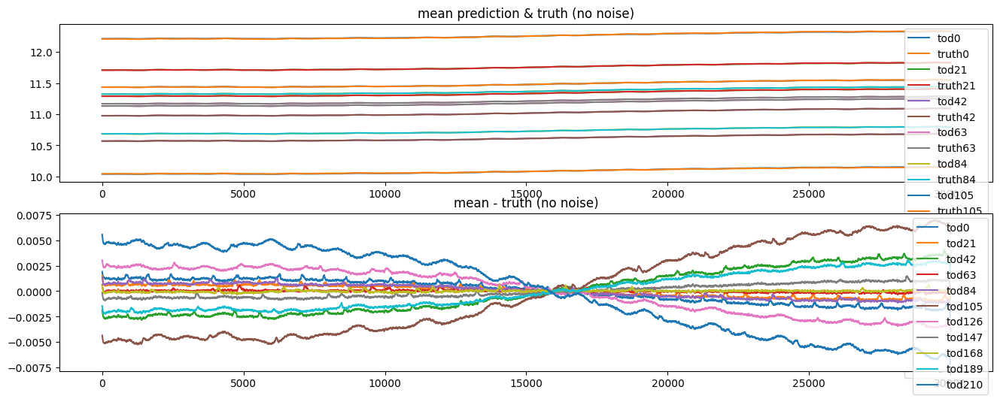

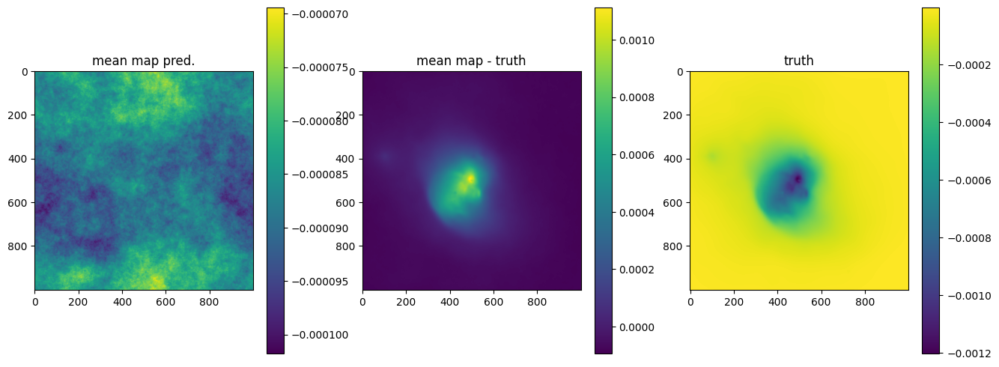

OPTIMIZE_KL: Starting 0025
SL: Iteration 0 ⛰:+3.5201e+22 Δ⛰:inf ➽:1.0322e+01
SL: Iteration 1 ⛰:+8.6758e+18 Δ⛰:3.5192e+22 ➽:1.0322e+01
SL: Iteration 2 ⛰:+7.7942e+17 Δ⛰:7.8964e+18 ➽:1.0322e+01
SL: Iteration 3 ⛰:+6.3464e+17 Δ⛰:1.4477e+17 ➽:1.0322e+01
SL: Iteration 4 ⛰:+3.0754e+17 Δ⛰:3.2710e+17 ➽:1.0322e+01
SL: Iteration 5 ⛰:+1.6207e+17 Δ⛰:1.4547e+17 ➽:1.0322e+01
SL: Iteration 6 ⛰:+2.8419e+16 Δ⛰:1.3365e+17 ➽:1.0322e+01
SL: Iteration 7 ⛰:+2.7708e+16 Δ⛰:7.1128e+14 ➽:1.0322e+01
SL: Iteration 8 ⛰:+1.0198e+16 Δ⛰:1.7510e+16 ➽:1.0322e+01
SL: Iteration 9 ⛰:+8.6370e+15 Δ⛰:1.5607e+15 ➽:1.0322e+01
SL: Iteration 10 ⛰:+8.6344e+15 Δ⛰:2.6830e+12 ➽:1.0322e+01
SL: Iteration 11 ⛰:+8.6312e+15 Δ⛰:3.1430e+12 ➽:1.0322e+01
SL: Iteration 12 ⛰:+5.3429e+15 Δ⛰:3.2883e+15 ➽:1.0322e+01
SL: Iteration 13 ⛰:+3.5017e+15 Δ⛰:1.8412e+15 ➽:1.0322e+01
SL: Iteration 14 ⛰:+3.4980e+15 Δ⛰:3.6680e+12 ➽:1.0322e+01
SL: Iteration 15 ⛰:+2.8303e+15 Δ⛰:6.6773e+14 ➽:1.0322e+01
SL: Iteration 16 ⛰:+2.8162e+15 Δ⛰:1.4096e+13 ➽:1.0322e+01
SL: 

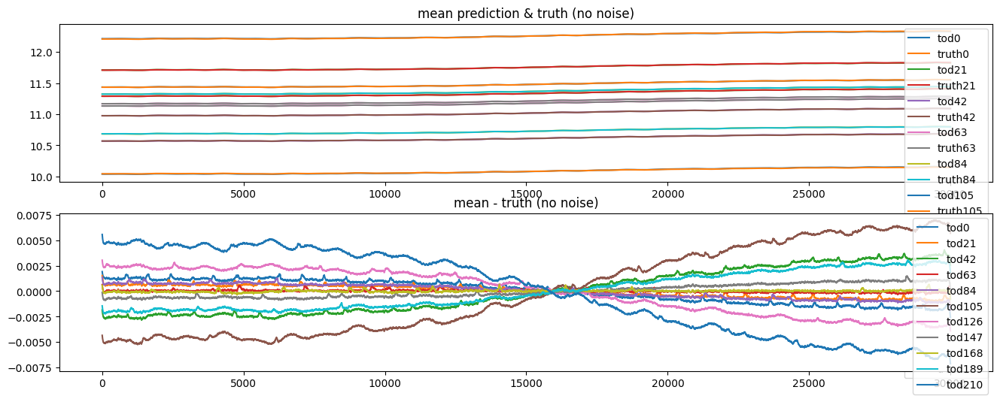

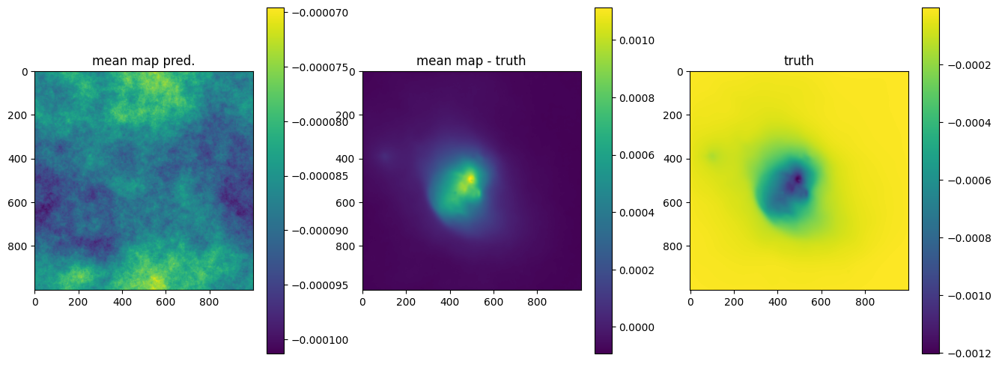

OPTIMIZE_KL: Starting 0026
SL: Iteration 0 ⛰:+3.6400e+22 Δ⛰:inf ➽:1.0322e+01
SL: Iteration 1 ⛰:+9.9126e+18 Δ⛰:3.6390e+22 ➽:1.0322e+01
SL: Iteration 2 ⛰:+2.9833e+18 Δ⛰:6.9293e+18 ➽:1.0322e+01
SL: Iteration 3 ⛰:+8.2751e+17 Δ⛰:2.1558e+18 ➽:1.0322e+01
SL: Iteration 4 ⛰:+3.9933e+17 Δ⛰:4.2818e+17 ➽:1.0322e+01
SL: Iteration 5 ⛰:+1.4087e+17 Δ⛰:2.5847e+17 ➽:1.0322e+01
SL: Iteration 6 ⛰:+2.9618e+16 Δ⛰:1.1125e+17 ➽:1.0322e+01
SL: Iteration 7 ⛰:+2.7647e+16 Δ⛰:1.9710e+15 ➽:1.0322e+01
SL: Iteration 8 ⛰:+1.4884e+16 Δ⛰:1.2763e+16 ➽:1.0322e+01
SL: Iteration 9 ⛰:+1.1542e+16 Δ⛰:3.3417e+15 ➽:1.0322e+01
SL: Iteration 10 ⛰:+1.1513e+16 Δ⛰:2.9419e+13 ➽:1.0322e+01
SL: Iteration 11 ⛰:+9.6018e+15 Δ⛰:1.9108e+15 ➽:1.0322e+01
SL: Iteration 12 ⛰:+6.0972e+15 Δ⛰:3.5046e+15 ➽:1.0322e+01
SL: Iteration 13 ⛰:+4.5021e+15 Δ⛰:1.5951e+15 ➽:1.0322e+01
SL: Iteration 14 ⛰:+4.4957e+15 Δ⛰:6.4188e+12 ➽:1.0322e+01
SL: Iteration 15 ⛰:+3.5718e+15 Δ⛰:9.2389e+14 ➽:1.0322e+01
SL: Iteration 16 ⛰:+3.3763e+15 Δ⛰:1.9548e+14 ➽:1.0322e+01
SL: 

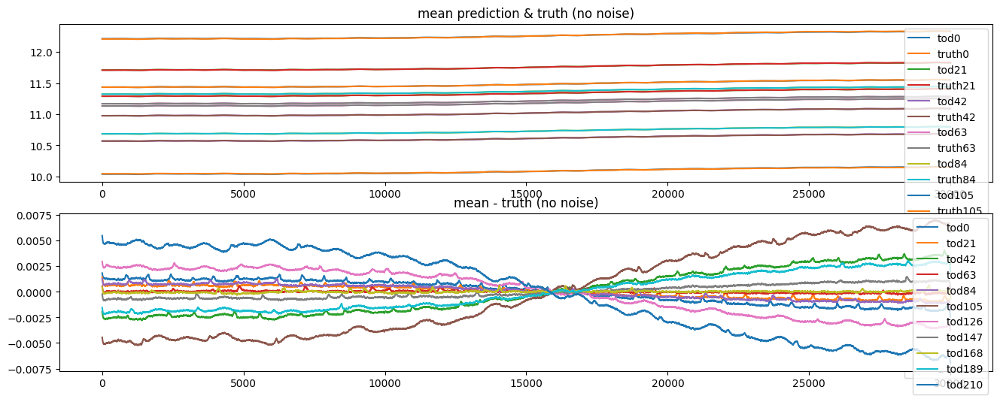

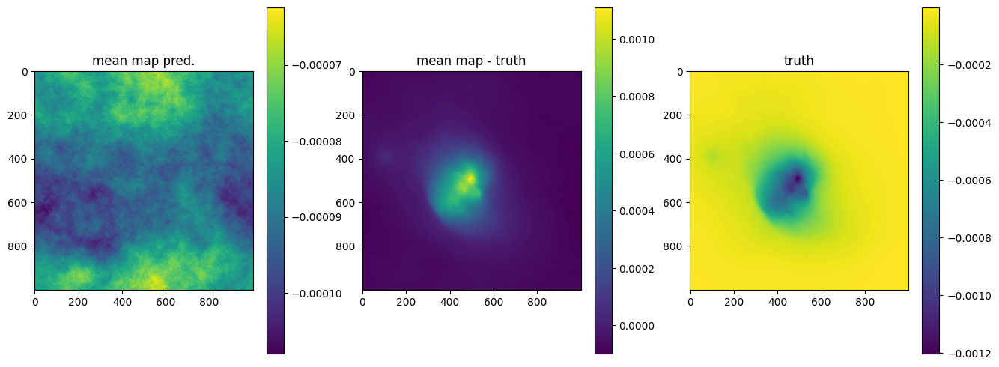

OPTIMIZE_KL: Starting 0027
SL: Iteration 0 ⛰:+3.5314e+22 Δ⛰:inf ➽:1.0322e+01
SL: Iteration 1 ⛰:+9.0108e+19 Δ⛰:3.5224e+22 ➽:1.0322e+01
SL: Iteration 2 ⛰:+9.7207e+17 Δ⛰:8.9136e+19 ➽:1.0322e+01
SL: Iteration 3 ⛰:+3.9814e+17 Δ⛰:5.7393e+17 ➽:1.0322e+01
SL: Iteration 4 ⛰:+2.6921e+17 Δ⛰:1.2893e+17 ➽:1.0322e+01
SL: Iteration 5 ⛰:+7.5738e+16 Δ⛰:1.9347e+17 ➽:1.0322e+01
SL: Iteration 6 ⛰:+2.6857e+16 Δ⛰:4.8881e+16 ➽:1.0322e+01
SL: Iteration 7 ⛰:+2.6766e+16 Δ⛰:9.1006e+13 ➽:1.0322e+01
SL: Iteration 8 ⛰:+1.1512e+16 Δ⛰:1.5254e+16 ➽:1.0322e+01
SL: Iteration 9 ⛰:+9.5075e+15 Δ⛰:2.0040e+15 ➽:1.0322e+01
SL: Iteration 10 ⛰:+8.8254e+15 Δ⛰:6.8214e+14 ➽:1.0322e+01
SL: Iteration 11 ⛰:+8.8166e+15 Δ⛰:8.7789e+12 ➽:1.0322e+01
SL: Iteration 12 ⛰:+6.0915e+15 Δ⛰:2.7251e+15 ➽:1.0322e+01
SL: Iteration 13 ⛰:+4.1435e+15 Δ⛰:1.9481e+15 ➽:1.0322e+01
SL: Iteration 14 ⛰:+3.9044e+15 Δ⛰:2.3907e+14 ➽:1.0322e+01
SL: Iteration 15 ⛰:+2.4895e+15 Δ⛰:1.4149e+15 ➽:1.0322e+01
SL: Iteration 16 ⛰:+2.4806e+15 Δ⛰:8.9289e+12 ➽:1.0322e+01
SL: 

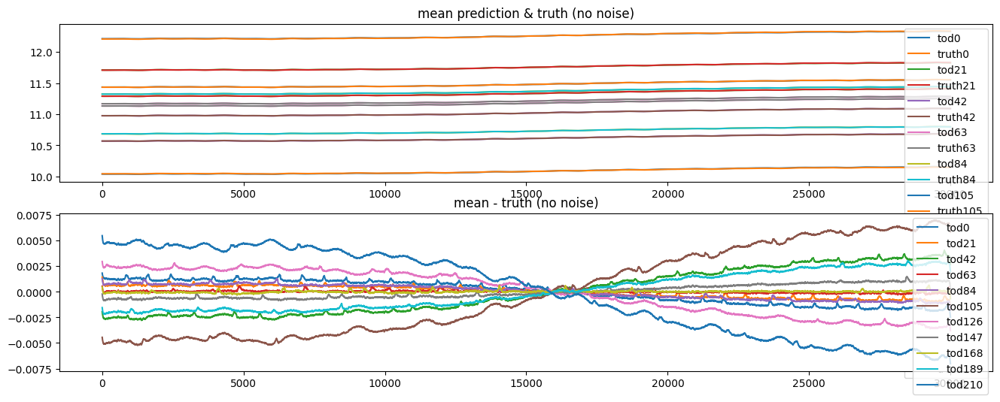

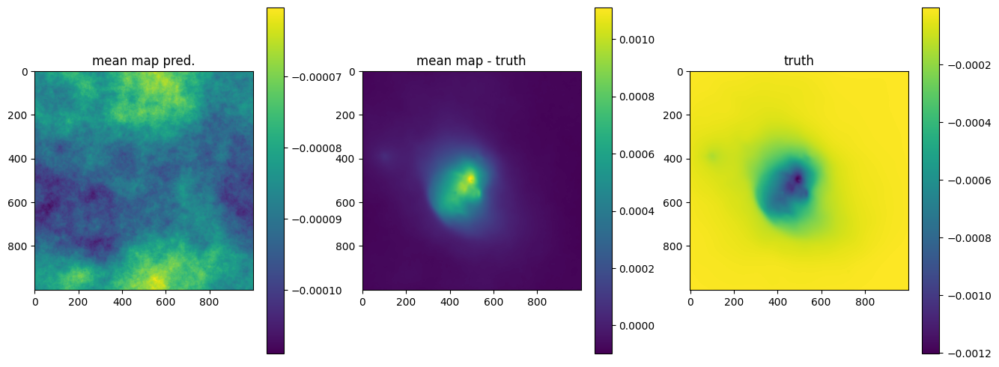

OPTIMIZE_KL: Starting 0028
SL: Iteration 0 ⛰:+3.2573e+22 Δ⛰:inf ➽:1.0322e+01
SL: Iteration 1 ⛰:+3.7253e+19 Δ⛰:3.2535e+22 ➽:1.0322e+01
SL: Iteration 2 ⛰:+1.0303e+18 Δ⛰:3.6223e+19 ➽:1.0322e+01
SL: Iteration 3 ⛰:+2.7531e+17 Δ⛰:7.5499e+17 ➽:1.0322e+01
SL: Iteration 4 ⛰:+1.7355e+17 Δ⛰:1.0175e+17 ➽:1.0322e+01
SL: Iteration 5 ⛰:+5.8481e+16 Δ⛰:1.1507e+17 ➽:1.0322e+01
SL: Iteration 6 ⛰:+2.0245e+16 Δ⛰:3.8236e+16 ➽:1.0322e+01
SL: Iteration 7 ⛰:+2.0044e+16 Δ⛰:2.0094e+14 ➽:1.0322e+01
SL: Iteration 8 ⛰:+7.2085e+15 Δ⛰:1.2835e+16 ➽:1.0322e+01
SL: Iteration 9 ⛰:+6.1136e+15 Δ⛰:1.0949e+15 ➽:1.0322e+01
SL: Iteration 10 ⛰:+6.1103e+15 Δ⛰:3.2835e+12 ➽:1.0322e+01
SL: Iteration 11 ⛰:+6.0575e+15 Δ⛰:5.2868e+13 ➽:1.0322e+01
SL: Iteration 12 ⛰:+4.5763e+15 Δ⛰:1.4812e+15 ➽:1.0322e+01
SL: Iteration 13 ⛰:+3.2925e+15 Δ⛰:1.2838e+15 ➽:1.0322e+01
SL: Iteration 14 ⛰:+3.0850e+15 Δ⛰:2.0752e+14 ➽:1.0322e+01
SL: Iteration 15 ⛰:+2.6935e+15 Δ⛰:3.9141e+14 ➽:1.0322e+01
SL: Iteration 16 ⛰:+2.6830e+15 Δ⛰:1.0559e+13 ➽:1.0322e+01
SL: 

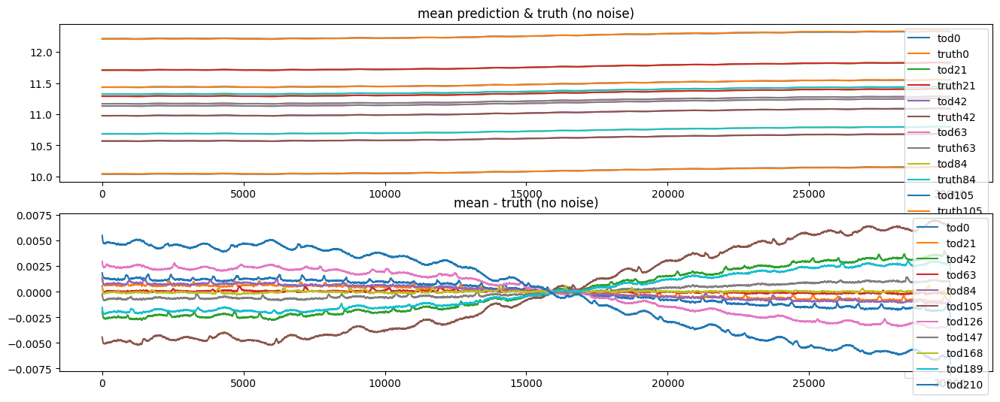

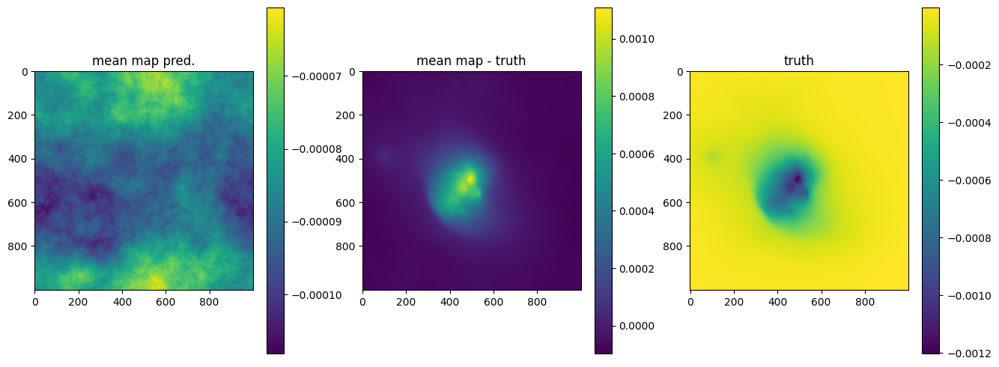

OPTIMIZE_KL: Starting 0029
SL: Iteration 0 ⛰:+2.8012e+22 Δ⛰:inf ➽:1.0322e+01
SL: Iteration 1 ⛰:+7.4898e+18 Δ⛰:2.8005e+22 ➽:1.0322e+01
SL: Iteration 2 ⛰:+9.4086e+17 Δ⛰:6.5489e+18 ➽:1.0322e+01
SL: Iteration 3 ⛰:+3.4200e+17 Δ⛰:5.9887e+17 ➽:1.0322e+01
SL: Iteration 4 ⛰:+3.2735e+17 Δ⛰:1.4647e+16 ➽:1.0322e+01
SL: Iteration 5 ⛰:+5.3640e+16 Δ⛰:2.7371e+17 ➽:1.0322e+01
SL: Iteration 6 ⛰:+2.4504e+16 Δ⛰:2.9136e+16 ➽:1.0322e+01
SL: Iteration 7 ⛰:+2.4345e+16 Δ⛰:1.5947e+14 ➽:1.0322e+01
SL: Iteration 8 ⛰:+1.2394e+16 Δ⛰:1.1950e+16 ➽:1.0322e+01
SL: Iteration 9 ⛰:+7.6660e+15 Δ⛰:4.7284e+15 ➽:1.0322e+01
SL: Iteration 10 ⛰:+7.6645e+15 Δ⛰:1.5403e+12 ➽:1.0322e+01
SL: Iteration 11 ⛰:+7.0343e+15 Δ⛰:6.3013e+14 ➽:1.0322e+01
SL: Iteration 12 ⛰:+5.6680e+15 Δ⛰:1.3664e+15 ➽:1.0322e+01
SL: Iteration 13 ⛰:+4.1630e+15 Δ⛰:1.5049e+15 ➽:1.0322e+01
SL: Iteration 14 ⛰:+3.9683e+15 Δ⛰:1.9474e+14 ➽:1.0322e+01
SL: Iteration 15 ⛰:+2.9997e+15 Δ⛰:9.6864e+14 ➽:1.0322e+01
SL: Iteration 16 ⛰:+2.9367e+15 Δ⛰:6.2971e+13 ➽:1.0322e+01
SL: 

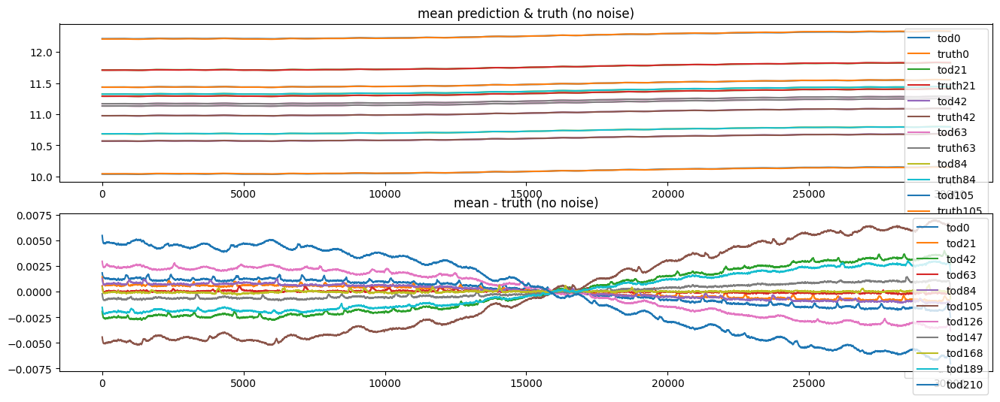

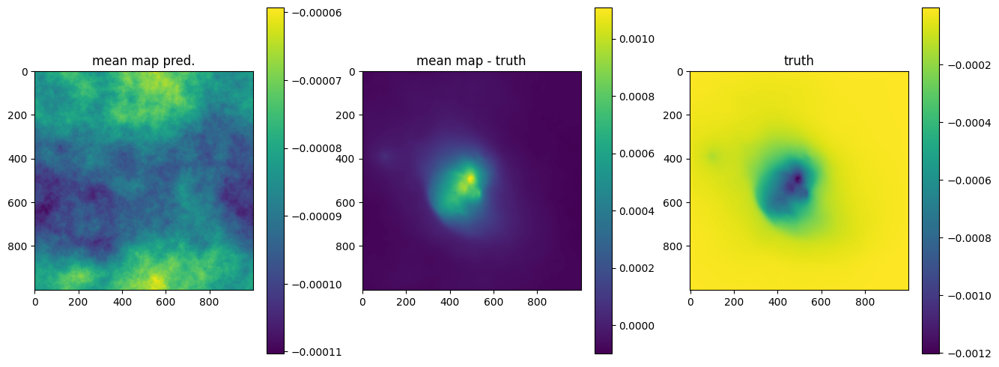

OPTIMIZE_KL: Starting 0030
SL: Iteration 0 ⛰:+3.4384e+22 Δ⛰:inf ➽:1.0322e+01
SL: Iteration 1 ⛰:+3.1924e+19 Δ⛰:3.4352e+22 ➽:1.0322e+01
SL: Iteration 2 ⛰:+2.8462e+18 Δ⛰:2.9078e+19 ➽:1.0322e+01
SL: Iteration 3 ⛰:+8.6554e+16 Δ⛰:2.7596e+18 ➽:1.0322e+01
SL: Iteration 4 ⛰:+7.6382e+16 Δ⛰:1.0172e+16 ➽:1.0322e+01
SL: Iteration 5 ⛰:+5.4993e+16 Δ⛰:2.1388e+16 ➽:1.0322e+01
SL: Iteration 6 ⛰:+2.3733e+16 Δ⛰:3.1260e+16 ➽:1.0322e+01
SL: Iteration 7 ⛰:+2.3455e+16 Δ⛰:2.7842e+14 ➽:1.0322e+01
SL: Iteration 8 ⛰:+9.5360e+15 Δ⛰:1.3919e+16 ➽:1.0322e+01
SL: Iteration 9 ⛰:+7.8479e+15 Δ⛰:1.6881e+15 ➽:1.0322e+01
SL: Iteration 10 ⛰:+7.8358e+15 Δ⛰:1.2136e+13 ➽:1.0322e+01
SL: Iteration 11 ⛰:+7.1772e+15 Δ⛰:6.5855e+14 ➽:1.0322e+01
SL: Iteration 12 ⛰:+5.5780e+15 Δ⛰:1.5992e+15 ➽:1.0322e+01
SL: Iteration 13 ⛰:+3.4971e+15 Δ⛰:2.0809e+15 ➽:1.0322e+01
SL: Iteration 14 ⛰:+2.6354e+15 Δ⛰:8.6171e+14 ➽:1.0322e+01
SL: Iteration 15 ⛰:+2.2066e+15 Δ⛰:4.2886e+14 ➽:1.0322e+01
SL: Iteration 16 ⛰:+2.1941e+15 Δ⛰:1.2517e+13 ➽:1.0322e+01
SL: 

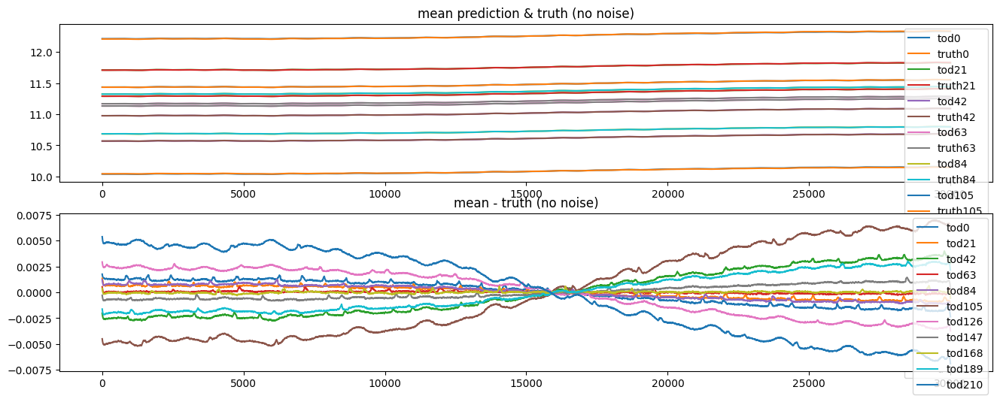

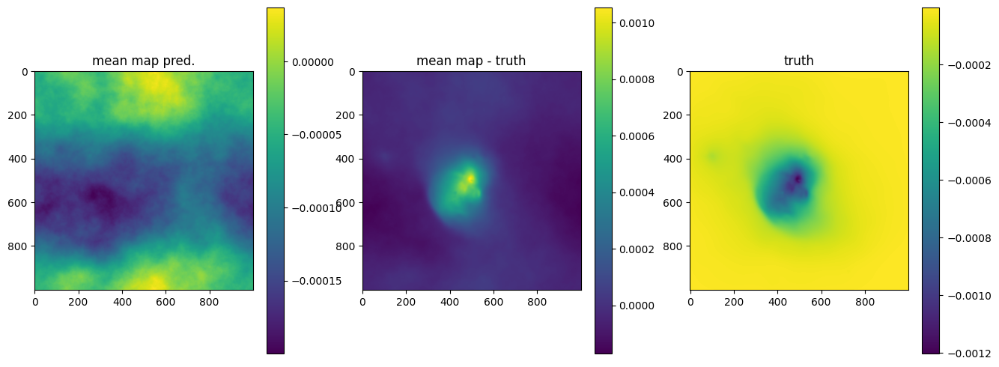

In [24]:
n_it = 30
# n_it = 50

if noiselevel == 0.0: delta = 1e-4
elif noiselevel == 0.1: delta = 1e-10
elif noiselevel == 0.5: delta = 1e-10
elif noiselevel == 1.0: delta = 1e-4
n_samples = 4 # no samples -> maximum aposteriory posterior

key, k_i, k_o = random.split(key, 3)

# callback fn for plotting during optimisation:
def callback(samples, opt_state):
    mean, std = jft.mean_and_std(tuple(signal_response_tod(s) for s in samples))

    fig_tods, axes_tods = plt.subplots(2, 1, figsize=(16, 6))

    # for i in range(0, mean.shape[0], mean.shape[0]//10):
    # for i in range(n):
    for i in range(0, n, n//10):
        axes_tods[0].plot(np.arange(0, mean.shape[1]), mean[i], label=f"tod{i}")
        axes_tods[0].plot(denoised_jax_tod[i], label=f"truth{i}")
        axes_tods[1].plot(np.arange(0, mean.shape[1]), mean[i] - denoised_jax_tod[i], label=f"tod{i}")

    axes_tods[0].title.set_text('mean prediction & truth (no noise)')
    axes_tods[0].legend()
    axes_tods[1].title.set_text('mean - truth (no noise)')
    axes_tods[1].legend()

    fig_map, axes_map = plt.subplots(1, 3, figsize=(16, 6))

    mean_map, _ = jft.mean_and_std(tuple(gp_map(s) for s in samples))

    im0 = axes_map[0].imshow(mean_map)
    axes_map[0].title.set_text('mean map pred.')
    fig_map.colorbar(im0)

    im1 = axes_map[1].imshow(mean_map - mapdata_truth[0])
    axes_map[1].title.set_text('mean map - truth')
    fig_map.colorbar(im1)

    im2 = axes_map[2].imshow(mapdata_truth[0])
    axes_map[2].title.set_text('truth')
    fig_map.colorbar(im2)

    plt.show()
    

samples, state = jft.optimize_kl(
    lh, # likelihood
    jft.Vector(lh.init(k_i)), # initial position in model space (initialisation)
    n_total_iterations=n_it, # no of optimisation steps (global)
    n_samples=n_samples, # draw samples
    key=k_o, # random jax init
    draw_linear_kwargs=dict( # sampling parameters
        cg_name="SL",
        cg_kwargs=dict(absdelta=delta * jft.size(lh.domain) / 10.0, maxiter=60),
        # cg_kwargs=dict(absdelta=delta * jft.size(lh.domain) / 10.0, maxiter=10),
    ),
    nonlinearly_update_kwargs=dict( # map from multivariate gaussian to more compl. distribution (coordinate transformations)
        minimize_kwargs=dict(
            name="SN",
            xtol=delta,
            cg_kwargs=dict(name=None),
            maxiter=5,
        )
    ),
    kl_kwargs=dict( # shift transformed multivar gauss to best match true posterior
        minimize_kwargs=dict(
            name="M", xtol=delta, cg_kwargs=dict(name=None), maxiter=60
            # name="M", xtol=delta, cg_kwargs=dict(name=None), maxiter=10
        )
    ),
    # sample_mode="nonlinear_resample", # how steps are combined (samples + nonlin + KL)
    sample_mode = lambda x: "nonlinear_resample" if x >= 1 else "linear_resample",
    callback=callback,
)

In [ ]:
printfitresults()

Fit Results (res, init, std)

TODs:
	fluctuations: 0.003398745732356031, 0.005, 0.003
	loglogvarslope: -2.643956458589078, -3, 0.5
	zeromode std (LogNormal): 9.857153454823955e-05, 0.0005, 0.001
map:
	fluctuations: 2.130647344809439e-05, 2e-06, 1e-06
	loglogvarslope: -3.7429283225319727, -2.5, 0.5
	zeromode std (LogNormal): 2.951566837397052e-10, 1e-08, 1e-07


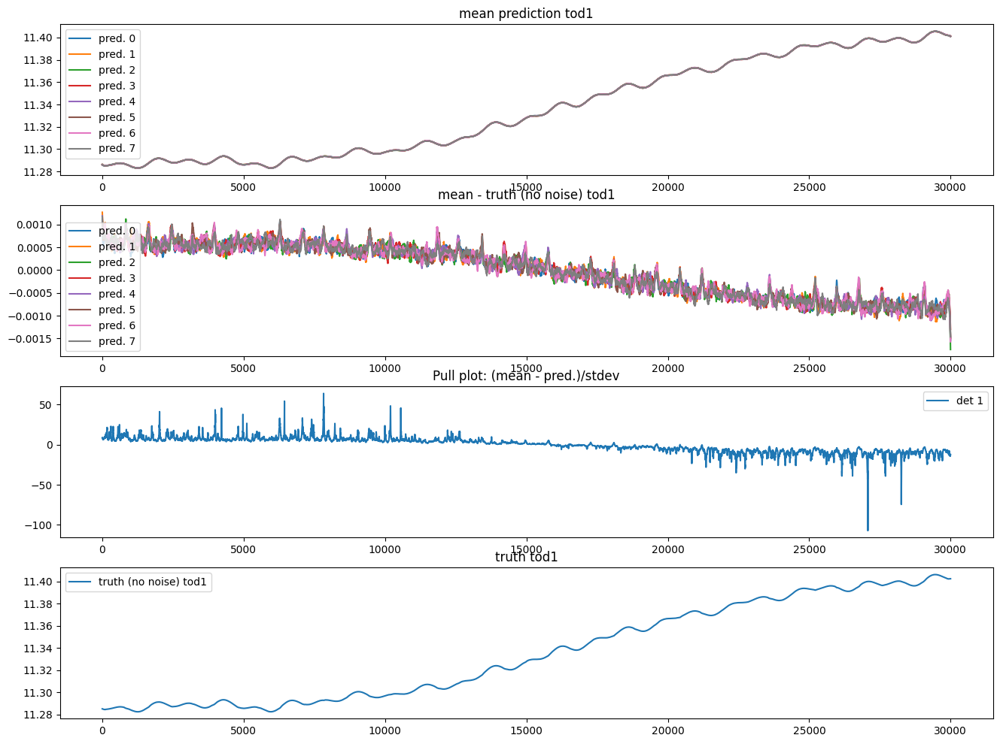

In [26]:
mean, std = jft.mean_and_std(tuple(signal_response_tod(s) for s in samples))

fig, axes = plt.subplots(4, 1, figsize=(16, 12))
i = 1 # TOD id
j = 0
# for i in range(mean.shape[0]):
for s in samples:
    pred = signal_response_tod(s)
    
    im0 = axes[0].plot(np.arange(0, pred.shape[1]), pred[i], label=f"pred. {j}")
    im1 = axes[1].plot(np.arange(0, pred.shape[1]), pred[i] - denoised_jax_tod[i], label=f"pred. {j}")
    j += 1

im2 = axes[2].plot(np.arange(0, pred.shape[1]), (mean[i] - denoised_jax_tod[i])/std[i], label=f"det {i}")
im3 = axes[3].plot(denoised_jax_tod[i], label=f"truth (no noise) tod{i}")
axes[0].title.set_text(f"mean prediction tod{i}")
axes[0].legend()
axes[1].title.set_text(f"mean - truth (no noise) tod{i}")
axes[1].legend()
axes[2].title.set_text(f"Pull plot: (mean - pred.)/stdev")
axes[2].legend()
axes[3].title.set_text(f"truth tod{i}")
axes[3].legend()

plt.show()

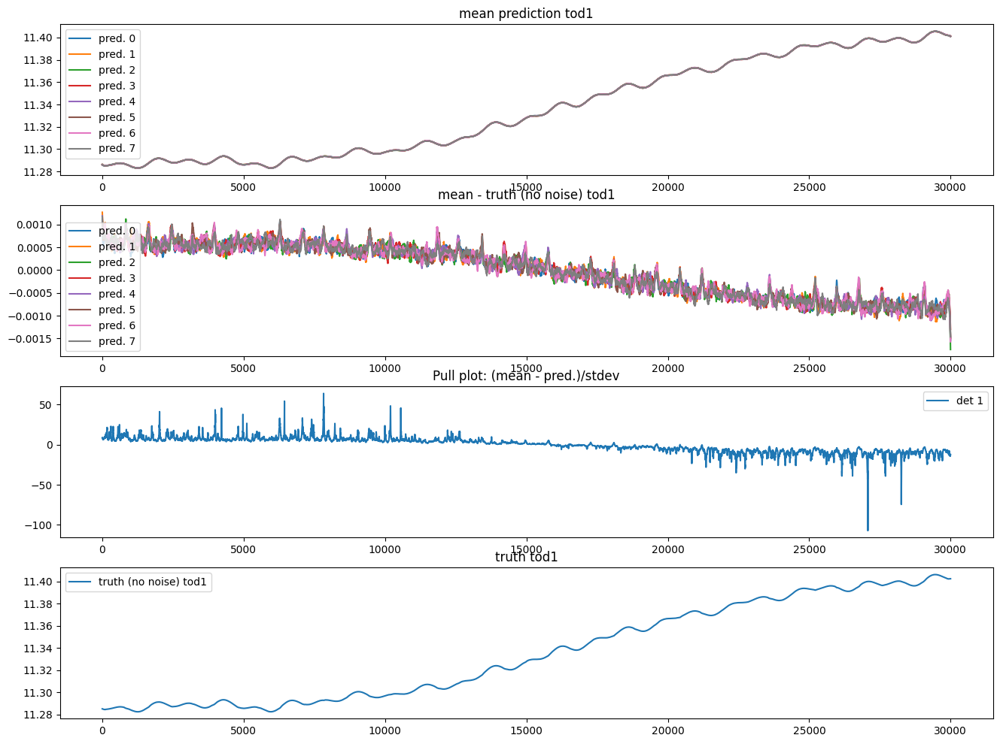

In [ ]:
fig, axes = plt.subplots(4, 1, figsize=(16, 12))
i = 1 # TOD id
j = 0
# for i in range(mean.shape[0]):
for s in samples:
    pred = signal_response_tod(s)
    
    im0 = axes[0].plot(np.arange(0, pred.shape[1]), pred[i], label=f"pred. {j}")
    im1 = axes[1].plot(np.arange(0, pred.shape[1]), pred[i] - denoised_jax_tod[i], label=f"pred. {j}")
    j += 1

im2 = axes[2].plot(np.arange(0, pred.shape[1]), (mean[i] - denoised_jax_tod[i])/std[i], label=f"det {i}")
im3 = axes[3].plot(denoised_jax_tod[i], label=f"truth (no noise) tod{i}")
axes[0].title.set_text(f"mean prediction tod{i}")
axes[0].legend()
axes[1].title.set_text(f"mean - truth (no noise) tod{i}")
axes[1].legend()
axes[2].title.set_text(f"Pull plot: (mean - pred.)/stdev")
axes[2].legend()
axes[3].title.set_text(f"truth tod{i}")
axes[3].legend()

plt.show()

## Compare with maria mapper:

In [28]:
from maria.map.mappers import BinMapper

mapper = BinMapper(center=(150, 10),
                   frame="ra_dec",
                   width=0.1,
                   height=0.1,
                   resolution=2e-4,
                   tod_preprocessing={
                        "window": {"tukey": {"alpha": 0.1}},
                        "remove_modes": {"n": 1},
                        "filter": {"f_lower": 0.01},
                        "despline": {"knot_spacing": 5},
                                    },
                    map_postprocessing={
                        "gaussian_filter": {"sigma": 1},
                        "median_filter": {"size": 1},
                                    },
                   units="K_RJ",
                   tods=[tod_truthmap],
                   )

output_map = mapper.run()

Running mapper (m2/f093): 100%|██████████| 1/1 [00:06<00:00,  6.27s/it]


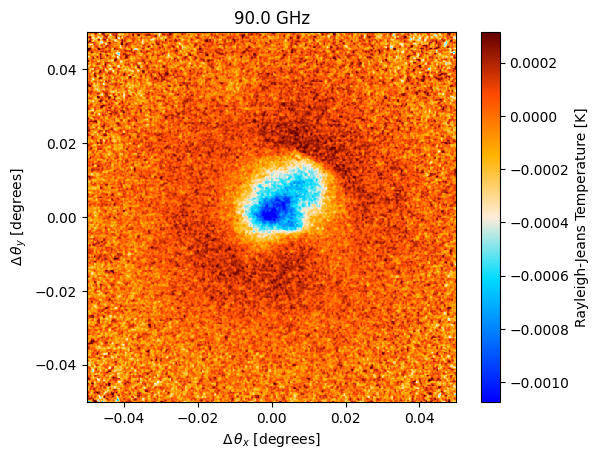

In [29]:
output_map.plot()

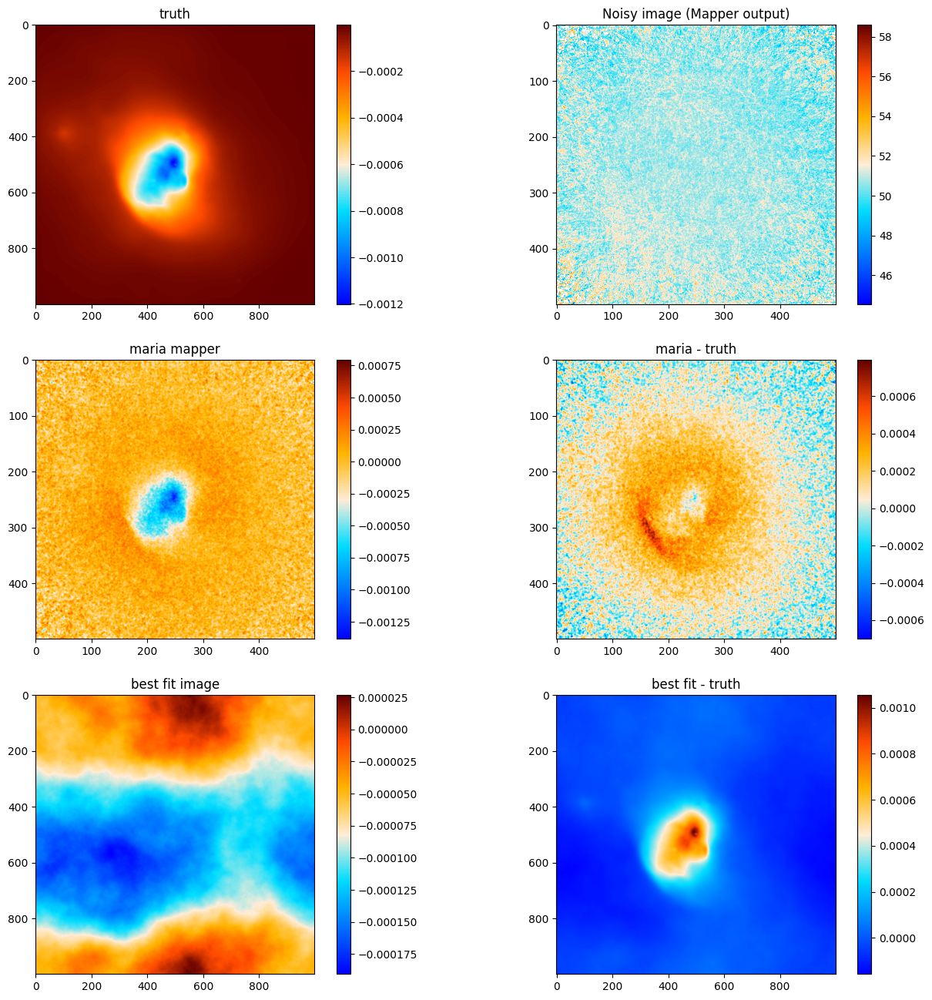

In [30]:
from skimage.transform import resize

# Compare nifty vs maria
sig_map = gp_map(samples.pos) # when splitting up in different field models
# mincol = -0.0012
# maxcol = 0.
mincol = None
maxcol = None

cmb_cmap = plt.get_cmap('cmb')
fig, axes = plt.subplots(3, 2, figsize=(16, 16))

im0 = axes[0,0].imshow( mapdata_truth[0] , cmap=cmb_cmap, vmin=mincol, vmax=maxcol)
axes[0,0].title.set_text('truth')
fig.colorbar(im0)

im1 = axes[0,1].imshow(output_truthmap.data[0], cmap=cmb_cmap, vmin=mincol, vmax=maxcol)
fig.colorbar(im1)
axes[0,1].title.set_text("Noisy image (Mapper output)")

im2 = axes[1,0].imshow(output_map.data[0], cmap=cmb_cmap, vmin=mincol, vmax=maxcol)
axes[1,0].title.set_text('maria mapper')
fig.colorbar(im2)

truth_rescaled = resize(mapdata_truth[0], (500, 500), anti_aliasing=True)
im3 = axes[1,1].imshow((output_map.data[0] - truth_rescaled), cmap=cmb_cmap, vmin=mincol, vmax=maxcol)
axes[1,1].title.set_text('maria - truth')
fig.colorbar(im3)

im3 = axes[2,0].imshow(sig_map, cmap=cmb_cmap, vmin=mincol, vmax=maxcol)
axes[2,0].title.set_text('best fit image')
fig.colorbar(im3)

im4 = axes[2,1].imshow((sig_map - mapdata_truth[0]), cmap=cmb_cmap, vmin=mincol, vmax=maxcol)
axes[2,1].title.set_text('best fit - truth')
fig.colorbar(im4)

plt.show()